# KDD 2010

## Preliminaries

### Import Packages

In [3]:
from utilities import * 

### Constants

In [4]:
# paths
PATH_TO_INTERACTION_DATA = '../../../../../data/kdd_2010/algebra_2005_2006_train.txt'

# dataset name
DATASET_NAME = 'kdd_2010'

# fields used in the analysis
USER_FIELD = 'Anon Student Id'
GROUP_FIELD = 'Problem Hierarchy'
LEARNING_ACTIVITY_FIELD = 'Problem Name'
COURSE_FIELD = 'Course'
TIMESTAMP_FIELD = 'Step Start Time'

# fields used in dataset preparation
INCORRECTS_FIELD = 'Incorrects'
HINTS_FIELD = 'Hints'
CORRECT_TRANSACTION_TIME_FIELD = 'Correct Transaction Time'
CORRECT_FIRST_ATTEMPT_FIELD = 'Correct First Attempt'

# strings and values used in dataset preparation

# evaluation fields
# learning activity level
EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD = None
EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD = None
# group level
EVALUATION_GROUP_SCORE_FIELD = None
EVALUATION_GROUP_IS_CORRECT_FIELD = None 
# course level
EVALUATION_COURSE_SCORE_FIELD = None
EVALUATION_COURSE_IS_CORRECT_FIELD = None 

# score threshold is correct
EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD = None
EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD = None
EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD = None

# evaluation min and max in dataset docu
EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU = None

# used for generating html tables
HTML_TABLES_DATA_LIST = [[LEARNING_ACTIVITY_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD, EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD, EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [GROUP_FIELD, EVALUATION_GROUP_SCORE_FIELD, EVALUATION_GROUP_IS_CORRECT_FIELD, EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD, EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [COURSE_FIELD, EVALUATION_COURSE_SCORE_FIELD, EVALUATION_COURSE_IS_CORRECT_FIELD, EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD, EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU]]

### Import Pickled Objects

In [5]:
# seq_distances = pickle_read(PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
#                             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

# learning_activity_sequence_stats_per_group = pickle_read(PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
#                                                          DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

# html_table = pickle_read(PATH_TO_HTML_TABLES_PICKLE_FOLDER,
#                          DATASET_NAME + HTML_TABLES_PICKLE_NAME)

# cluster_eval = pickle_read(PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
#                            DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

### Functions

In [6]:
# test = interactions.loc[(interactions[USER_FIELD]=='0')&(interactions[LEARNING_ACTIVITY_FIELD]=='1'), :]

In [7]:
# calculate_eval_metrics(test,
#                        incorrects_field=INCORRECTS_FIELD,
#                        hints_field=HINTS_FIELD,
#                        correct_transaction_time_field=CORRECT_TRANSACTION_TIME_FIELD,
#                        correct_first_attempt_field=CORRECT_FIRST_ATTEMPT_FIELD)

In [8]:
def calculate_eval_metrics(df: pd.DataFrame,
                           incorrects_field=None,
                           hints_field=None,
                           correct_transaction_time_field=None,
                           correct_first_attempt_field=None):
    """Calculate evaluation metrics per single learning_activity. This function should be used as input of the
    add_evaluation_fields function.

    Parameters
    ----------
    df : pd.DataFrame
        A subset of the interactions dataframe containing data of a single learning_activity
    incorrects_field : _type_
        The incorrects field, by default None
    hints_field : _type_
        The hints field, by default None
    correct_transaction_time_field : _type_
        The correct_transaction_time field, by default None
    correct_first_attempt_field : _type_
        The correct_first_attemp_field field, by default None

    Returns
    -------
    tuple
        A tuple of evaluation metric scalars per learning activity
    """

    correct_field = 'correct'
    df = df.copy()
    df[correct_field] = df[correct_transaction_time_field].notna().astype(int)
    # number interactions (Avg sum corrects, sum incorrects, sum hints)
    number_interactions_total = df[[correct_field, hints_field, incorrects_field]].apply(sum, axis=1).mean()

    # number attempts
    number_attempts_total = df[[correct_field, incorrects_field]].apply(sum, axis=1).mean()

    # number hints
    number_hints_total = df[hints_field].mean()
    
    # scores
    # single score
    single_score = df[correct_first_attempt_field].mean() 
    # single score hint taken equal lowest
    if df[hints_field].any():
        single_score_hint_lowest = 0
    else:
        single_score_hint_lowest = df[correct_first_attempt_field].mean() 
    # single score not first attempt equal lowest
    if not df[correct_first_attempt_field].all():
        single_score_not_first_attempt_lowest = 0
    else:
        single_score_not_first_attempt_lowest = df[correct_first_attempt_field].mean()
    # highest score
    score_highest = None
    # highest score without hint
    score_highest_without_hint = None
    # score first attempt
    score_first_attempt = None
    # score last attempt
    score_last_attempt = None
    # number interactions until highest score
    number_interactions_until_score_highest = None
    # number attempts until highest score
    number_attempts_until_score_highest = None
    # number hints until highest score
    number_hints_until_score_highest = None

    # corrects
    # correct
    is_correct = df[correct_field].all()
    # correct without hint
    if is_correct:
        is_correct_without_hint = not df[hints_field].any()
    else:
        is_correct_without_hint = False
    # correct first attempt
    if is_correct:
        is_correct_first_attempt = not df[incorrects_field].any() 
    else:
        is_correct_first_attempt = False
    # correct first attempt without hint
    if is_correct:
        is_correct_first_attempt_without_hint = (not df[incorrects_field].any()) and (not df[hints_field].any())
    else:
        is_correct_first_attempt_without_hint = False
    # correct last attempt
    is_correct_last_attempt = None
    # correct last attempt without hint
    is_correct_last_attempt_without_hint = None
    # number interactions until correct
    if is_correct:
        number_interactions_until_correct = df[[incorrects_field, hints_field]].apply(sum, axis=1).add(1).mean()
    else:
        number_interactions_until_correct = -1 # -1 means that there was no correct -> therefore also no interactions until correct
    # number attempts until correct
    if is_correct:
        number_attempts_until_correct = df[incorrects_field].add(1).mean()
    else:
        number_attempts_until_correct = -1 # -1 means that there was no correct -> therefore also no attempts until correct
    # number hints until correct
    number_hints_until_correct = df[hints_field].mean()

    return (number_interactions_total,
            number_attempts_total,
            number_hints_total,
            single_score,
            single_score_hint_lowest,
            single_score_not_first_attempt_lowest,
            score_highest,
            score_highest_without_hint,
            score_first_attempt,
            score_last_attempt,
            number_interactions_until_score_highest,
            number_attempts_until_score_highest,
            number_hints_until_score_highest,
            is_correct,
            is_correct_without_hint,
            is_correct_first_attempt,
            is_correct_first_attempt_without_hint,
            is_correct_last_attempt,
            is_correct_last_attempt_without_hint,
            number_interactions_until_correct,
            number_attempts_until_correct,
            number_hints_until_correct)

## Dataset Preparation

### Import Data

In [9]:
interactions = pd.read_csv(PATH_TO_INTERACTION_DATA, sep='\t')

### Set Data Type

In [10]:
interactions = typecast_fields(interactions,
                               TIMESTAMP_FIELD,
                               GROUP_FIELD,
                               USER_FIELD,
                               LEARNING_ACTIVITY_FIELD)

### Merge and Filter Data

### Transform Categorical Variable Values

In [11]:
interactions, value_mapping_df = map_new_to_old_values(interactions, 
                                                       GROUP_FIELD, 
                                                       USER_FIELD, 
                                                       LEARNING_ACTIVITY_FIELD)

### Filter Sequences by NAs in Dataset 

In [12]:
pct_na = get_nas_in_data(interactions)
pct_na

Row                                            0.0 %
Anon Student Id                                0.0 %
Problem Hierarchy                              0.0 %
Problem Name                                   0.0 %
Problem View                                   0.0 %
Step Name                                      0.0 %
Step Start Time                0.11349966777572762 %
First Transaction Time                         0.0 %
Correct Transaction Time         3.192687607911137 %
Step End Time                                  0.0 %
Step Duration (sec)            0.11349966777572762 %
Correct Step Duration (sec)     23.411930926992174 %
Error Step Duration (sec)        76.70156874078356 %
Correct First Attempt                          0.0 %
Incorrects                                     0.0 %
Hints                                          0.0 %
Corrects                                       0.0 %
KC(Default)                     25.030320096233886 %
Opportunity(Default)            25.03032009623

In [13]:
interactions, na_indices_list = drop_learning_activity_sequence_if_contains_na_in_field(interactions, 
                                                                                        GROUP_FIELD, 
                                                                                        USER_FIELD, 
                                                                                        field_list=[LEARNING_ACTIVITY_FIELD, 
                                                                                                    TIMESTAMP_FIELD], 
                                                                                        field_value_tuple_filter_list=[])



Input length: 809694
Outpunt length: 743657
Number of rows removed: 66037
Percentage of rows removed: 8.1558%
--------------------------------------------------
Input number of sequences: 16118
Output number of sequences: 15448
Number of sequences removed: 670
Percentage of sequences removed: 4.1568%


In [14]:
interactions = drop_na_by_fields(interactions,
                                 field_list=[GROUP_FIELD,
                                             USER_FIELD])

Input length: 743657
Outpunt length: 743657
Number of rows removed: 0
Percentage of rows removed: 0%


In [15]:
pct_na = get_nas_in_data(interactions)
pct_na

Row                                           0.0 %
Anon Student Id                               0.0 %
Problem Hierarchy                             0.0 %
Problem Name                                  0.0 %
Problem View                                  0.0 %
Step Name                                     0.0 %
Step Start Time                               0.0 %
First Transaction Time                        0.0 %
Correct Transaction Time        3.039169939905091 %
Step End Time                                 0.0 %
Step Duration (sec)                           0.0 %
Correct Step Duration (sec)    23.072733800663478 %
Error Step Duration (sec)       76.92726619933651 %
Correct First Attempt                         0.0 %
Incorrects                                    0.0 %
Hints                                         0.0 %
Corrects                                      0.0 %
KC(Default)                    25.188763099116933 %
Opportunity(Default)           25.188763099116933 %
dtype: objec

### Sort by Timestamp

In [16]:
interactions = sort_by_timestamp(interactions, 
                                 TIMESTAMP_FIELD, 
                                 higher_level_sort_list=[GROUP_FIELD, USER_FIELD])

### Evaluation Score Fields Ranges

In [17]:
evaluation_score_range_dict = return_and_plot_evaluation_score_range(interactions,
                                                                     LEARNING_ACTIVITY_FIELD,
                                                                     None,
                                                                     None,
                                                                     None,
                                                                     None)

### Transform Data

#### Add Evaluation Fields

In [18]:
interactions = add_evaluation_fields(interactions,
                                     GROUP_FIELD,
                                     USER_FIELD,
                                     LEARNING_ACTIVITY_FIELD,
                                     TIMESTAMP_FIELD,
                                     None,
                                     np.mean,
                                     EVALUATION_GROUP_SCORE_FIELD,
                                     EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     EVALUATION_COURSE_SCORE_FIELD,
                                     EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     False,
                                     False,
                                     EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD,
                                     EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD,
                                     operator.gt,
                                     operator.gt,
                                     calculate_eval_metrics,
                                     incorrects_field=INCORRECTS_FIELD,
                                     hints_field=HINTS_FIELD,
                                     correct_transaction_time_field=CORRECT_TRANSACTION_TIME_FIELD,
                                     correct_first_attempt_field=CORRECT_FIRST_ATTEMPT_FIELD)

100%|██████████| 15448/15448 [00:01<00:00, 14114.81it/s]


= Repeated Interactions Removal =
Initial number of interactions: 743657
Final number of interactions: 71972
Removed number of interactions: 671685
Removed percentage of interactions: 90.32188226561439%


In [19]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71972 entries, 0 to 71971
Data columns (total 92 columns):
 #   Column                                                                                   Non-Null Count  Dtype         
---  ------                                                                                   --------------  -----         
 0   Row                                                                                      71972 non-null  int64         
 1   Anon Student Id                                                                          71972 non-null  object        
 2   Problem Hierarchy                                                                        71972 non-null  object        
 3   Problem Name                                                                             71972 non-null  object        
 4   Problem View                                                                             71972 non-null  int64         
 5   Step Name  

### Rename Fields

In [20]:
interactions, fields_mapping_df = rename_fields(interactions,
                                                GROUP_FIELD,
                                                USER_FIELD,
                                                LEARNING_ACTIVITY_FIELD,
                                                TIMESTAMP_FIELD)

### Add Sequence ID Field

In [21]:
interactions = add_sequence_id_field(interactions,
                                     GROUP_FIELD_NAME_STR,
                                     USER_FIELD_NAME_STR,
                                     LEARNING_ACTIVITY_FIELD_NAME_STR)

### Check Dataset

In [22]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71972 entries, 0 to 71971
Data columns (total 77 columns):
 #   Column                                                                                   Non-Null Count  Dtype         
---  ------                                                                                   --------------  -----         
 0   Timestamp                                                                                71972 non-null  datetime64[ns]
 1   User                                                                                     71972 non-null  object        
 2   Topic                                                                                    71972 non-null  object        
 3   Learning Resource                                                                        71972 non-null  object        
 4   Sequence ID                                                                              71972 non-null  object        
 5   Learning Re

In [23]:
pct_na = get_nas_in_data(interactions)
pct_na

Timestamp                                                                                    0.0 %
User                                                                                         0.0 %
Topic                                                                                        0.0 %
Learning Resource                                                                            0.0 %
Sequence ID                                                                                  0.0 %
Learning Resource Interactions Total                                                         0.0 %
Learning Resource Attempts Total                                                             0.0 %
Learning Resource Hints Total                                                                0.0 %
Learning Resource Single Score                                                               0.0 %
Learning Resource Single Score (Hint Taken Equals Lowest Score)                              0.0 %
Learning R

### Create HtmlTables Dataset Info Object

In [24]:
html_table = HtmlTables(DATASET_NAME,
                        interactions, 
                        evaluation_score_range_dict, 
                        HTML_TABLES_DATA_LIST)

### Save the Dataset, Mapping Information and HtmlTables Object 

In [25]:
save_interaction_and_mapping_df(interactions,
                                fields_mapping_df,
                                value_mapping_df,
                                PATH_TO_CLEANED_DATASETS,
                                DATASET_NAME)

In [26]:
pickle_write(html_table,
             PATH_TO_HTML_TABLES_PICKLE_FOLDER,
             DATASET_NAME + HTML_TABLES_PICKLE_NAME)

## Dataset Characteristics

### Dataset Information

---
**Has GROUPING Field:** True

---
**Available Evaluation Metrics**  
Possible Values: 
>- True 
>- False
>- Derived (For 'Is Correct' fields)

Score Threshold to be correct:   
>    Learning Activity Is Correct Threshold:  
>    Group Is Correct Threshold:  
>    Course Is Correct Threshold:  

>**I. Learning Activity Level**:

- **Number of Interactions Total:**

- **Number of Attempts Total:**

- **Number of Hints Total:**

- **Score Highest:**

- **Score Highest without Hint:**

- **Score First Attempt:**

- **Score Last Attempt:**

- **Number of Interactions until Highest Score:**

- **Number of Attempts until Highest Score:**

- **Number of Hints until Highest Score:**

- **Is Correct:**
        
- **Is Correct without Hint:**

- **Is Correct at First Attempt:**

- **Is Correct at First Attempt without Hint:**
        
- **Is Correct at Last Attempt :**

- **Is Correct at Last Attempt without Hint:**

- **Number of Interactions until Correct:**

- **Number of Attempts until Correct:**

- **Number of Hints until Correct:**


>**II. Group level**:

- **Group Score:**

- **Group Is Correct:**


>**III. Course level**:

- **Course Score:** True  
Final grades of course

- **Course Is Correct:** False

---
**Additional Information:**

### Available Fields

In [27]:
html_table.display_available_fields()

<table border="1" class="dataframe">
  <thead>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center"> </th>
      <th style = "background-color: royalblue; color: white; text-align:center">Is Available</th>
    </tr>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center">Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">kdd_2010</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Timestamp</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">User</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Sequence ID</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Hint Taken Equals Lowest Score)</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Not First Attempt Equals Lowest Score)</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score Without Hint</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct Without Hints</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct Without Hints</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score All Topics Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Topics Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
  </tbody>
</table>

### Score - Is_Correct Relationship

In [28]:
html_table.display_score_is_correct_relationship()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Score Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Is_Correct Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Chosen Score Is_Correct Threshold</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th rowspan="3" valign="top" style = "background-color: rgb(80, 80, 80); color: white">kdd_2010</th>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Learning Resource</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Topic</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Course</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
  </tbody>
</table>

### Summary Statistics

In [29]:
html_table.display_summary_statistics()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Interactions</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Users</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Topics</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Learning Resources</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Learning Resource Matrix %</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Topic Matrix %</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">kdd_2010</th>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">71972</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">568</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">138</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">1084</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">15448</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">6685</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">91.6</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">80.29</td>
    </tr>
  </tbody>
</table>

### Group-User-Learning_Activity Relationship

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Interactions per User:
----------------------------------------------------------------------------------------------------
mean: number of interactions per User: 126.71126760563381
median: number of interactions per User: 66.0
max: number of interactions per User: 813
min: number of interactions per User: 1
std: number of interactions per User: 144.03884842354324
iqr: number of interactions per User: 136.25


Plots:


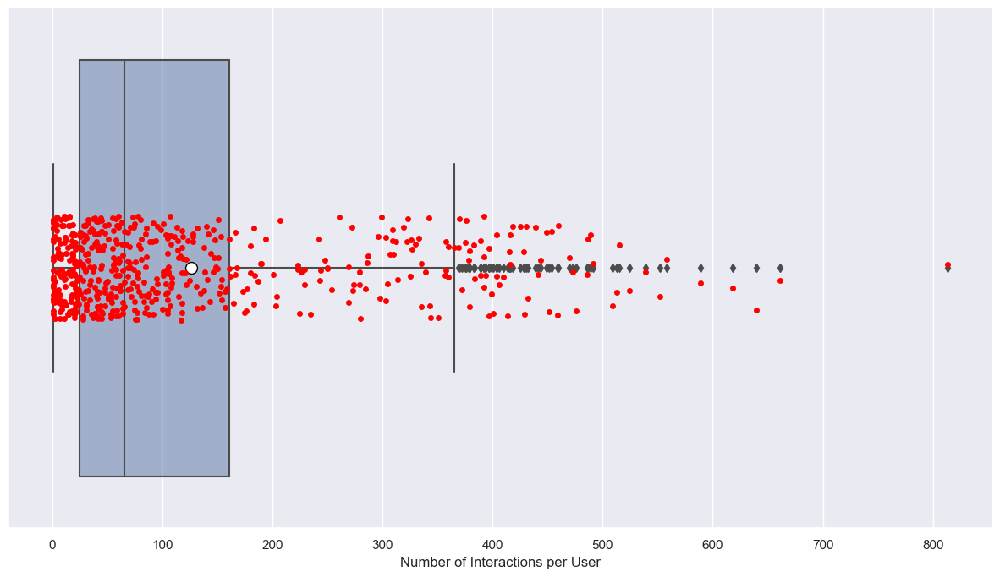

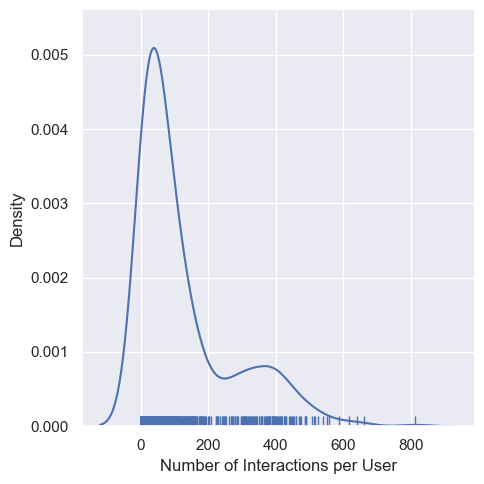

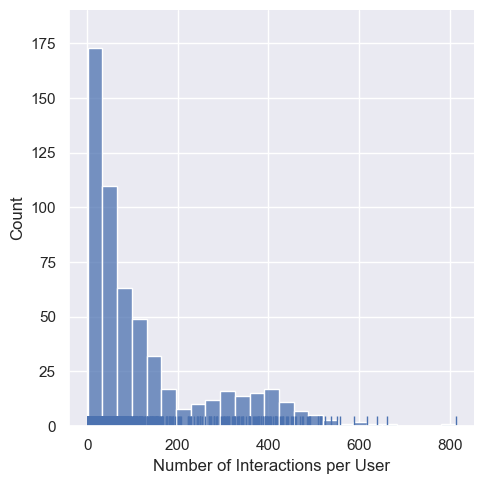

****************************************************************************************************
****************************************************************************************************
----------------------------------------------------------------------------------------------------
Number of Unique Topics per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per User: 27.197183098591548
median: Number of Unique Topics per User: 16.0
max: Number of Unique Topics per User: 126
min: Number of Unique Topics per User: 1
std: Number of Unique Topics per User: 28.446239882973014
iqr: Number of Unique Topics per User: 29.0


Plots:


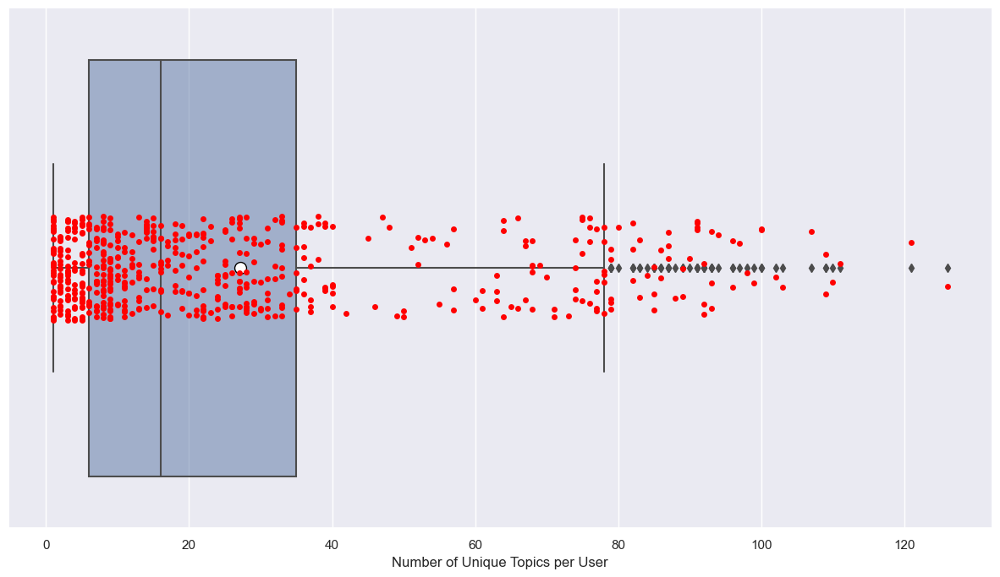

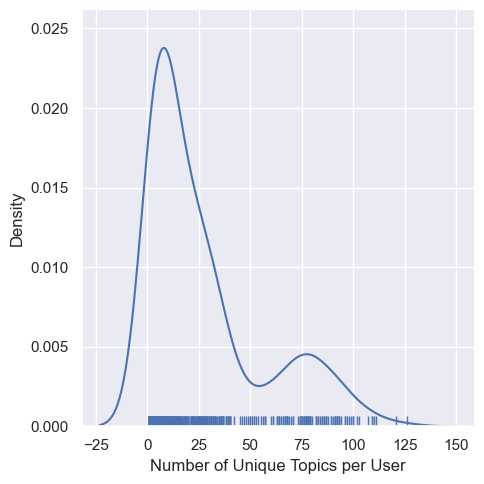

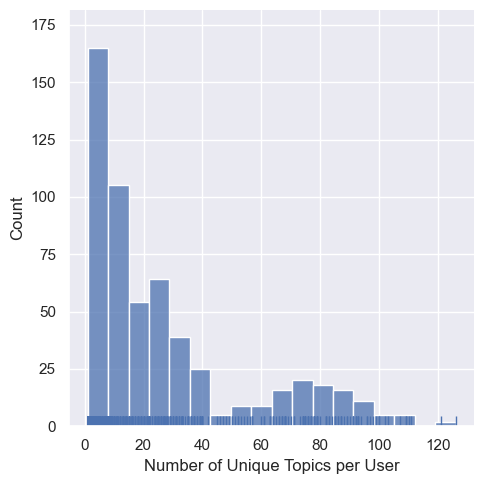

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per User: 91.07922535211267
median: Number of Unique Learning Resources per User: 48.0
max: Number of Unique Learning Resources per User: 568
min: Number of Unique Learning Resources per User: 1
std: Number of Unique Learning Resources per User: 103.03441519238764
iqr: Number of Unique Learning Resources per User: 94.0


Plots:


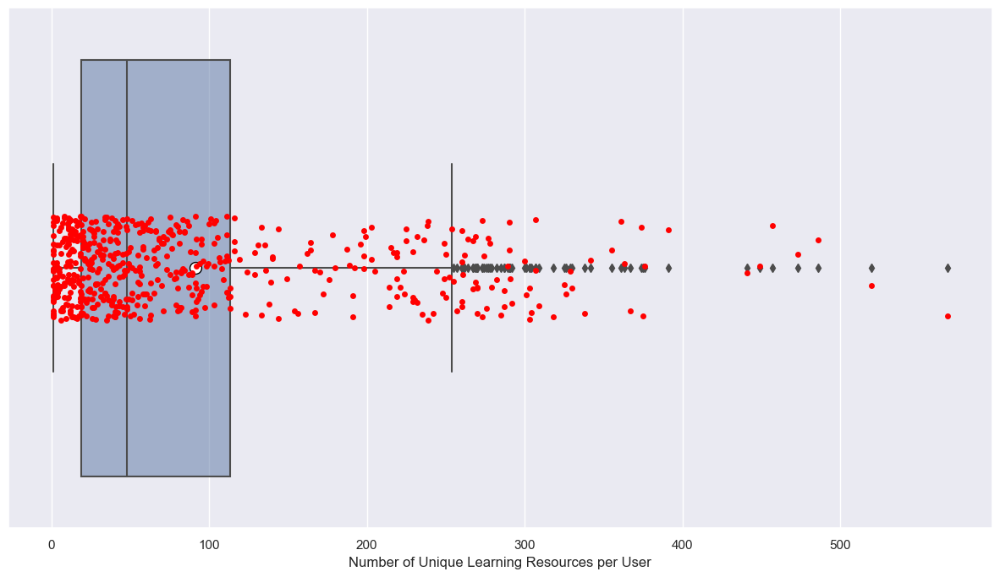

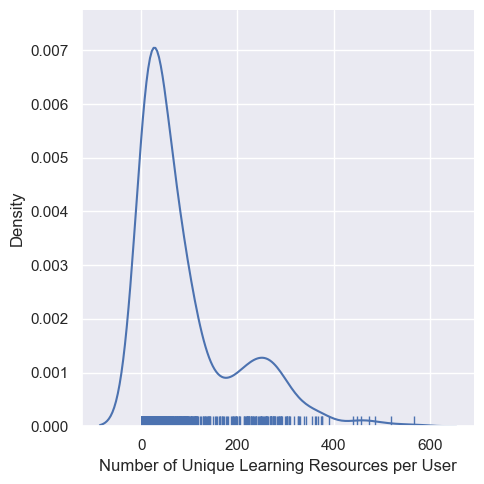

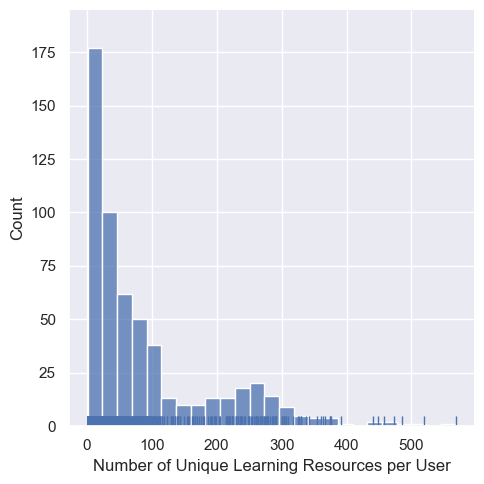

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Topic: 111.94202898550725
median: Number of Unique Users per Topic: 111.5
max: Number of Unique Users per Topic: 243
min: Number of Unique Users per Topic: 4
std: Number of Unique Users per Topic: 64.76648318967364
iqr: Number of Unique Users per Topic: 108.0


Plots:


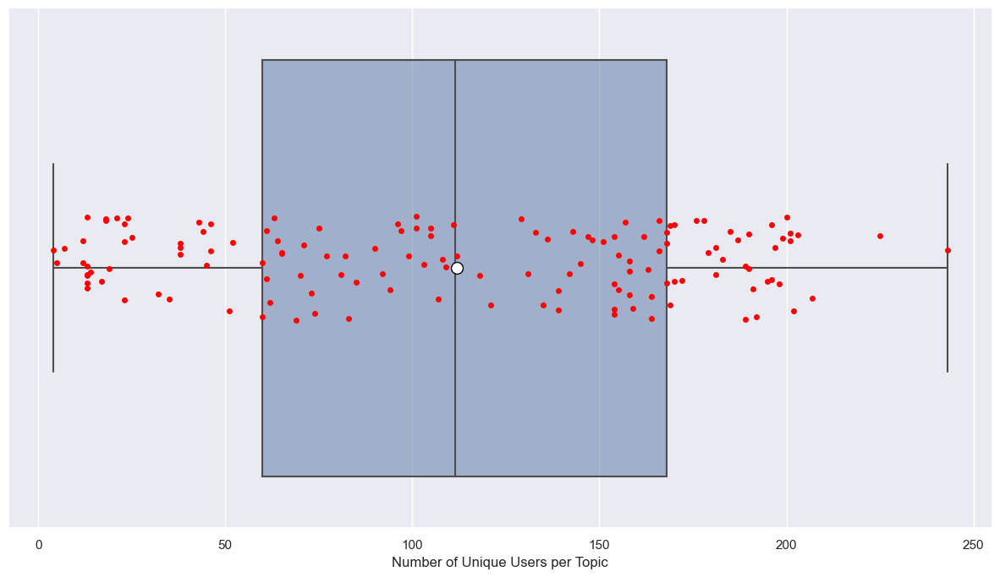

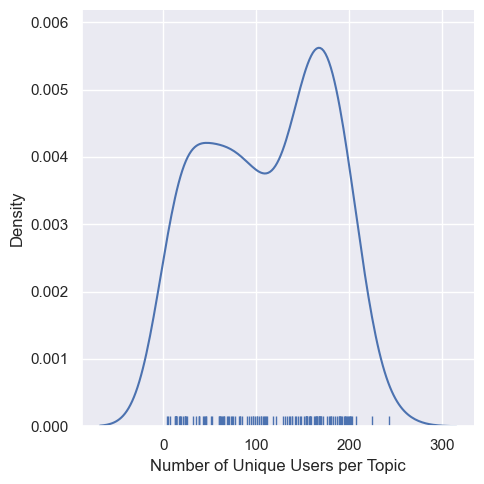

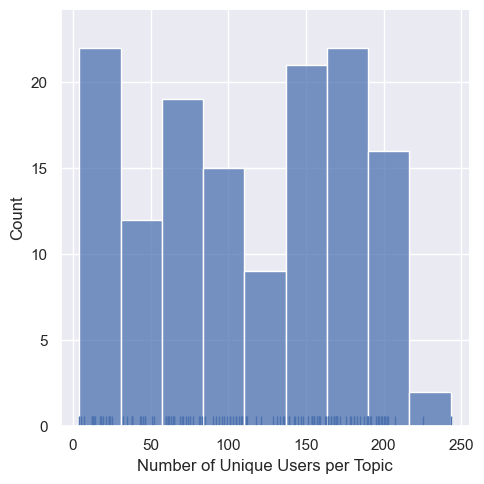

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per Topic: 8.73913043478261
median: Number of Unique Learning Resources per Topic: 6.0
max: Number of Unique Learning Resources per Topic: 44
min: Number of Unique Learning Resources per Topic: 1
std: Number of Unique Learning Resources per Topic: 8.965712747894232
iqr: Number of Unique Learning Resources per Topic: 11.0


Plots:


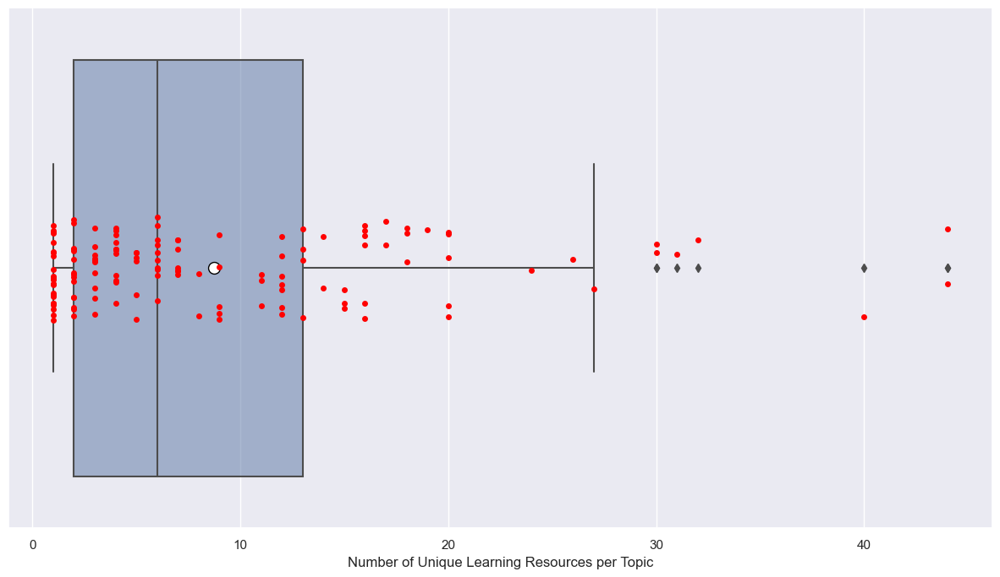

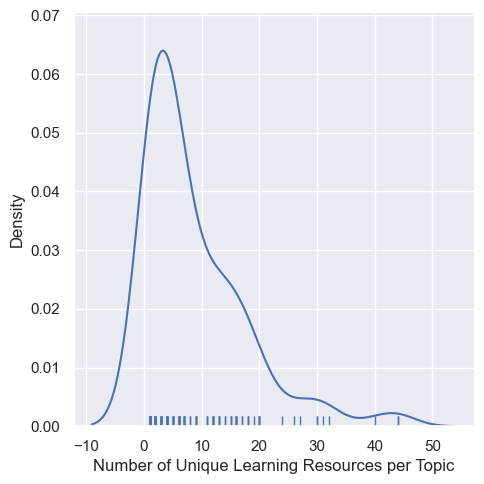

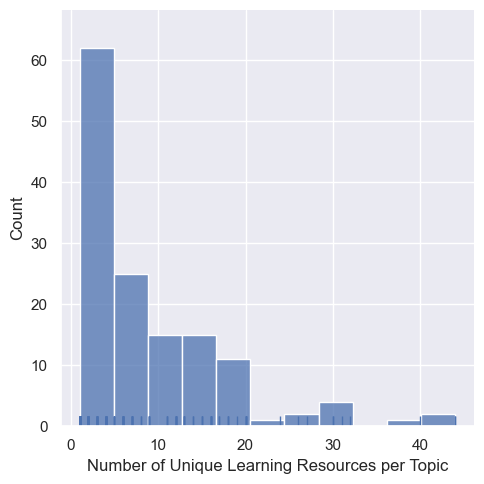

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Learning Resource: 47.724169741697416
median: Number of Unique Users per Learning Resource: 27.0
max: Number of Unique Users per Learning Resource: 276
min: Number of Unique Users per Learning Resource: 1
std: Number of Unique Users per Learning Resource: 52.86244564445708
iqr: Number of Unique Users per Learning Resource: 54.0


Plots:


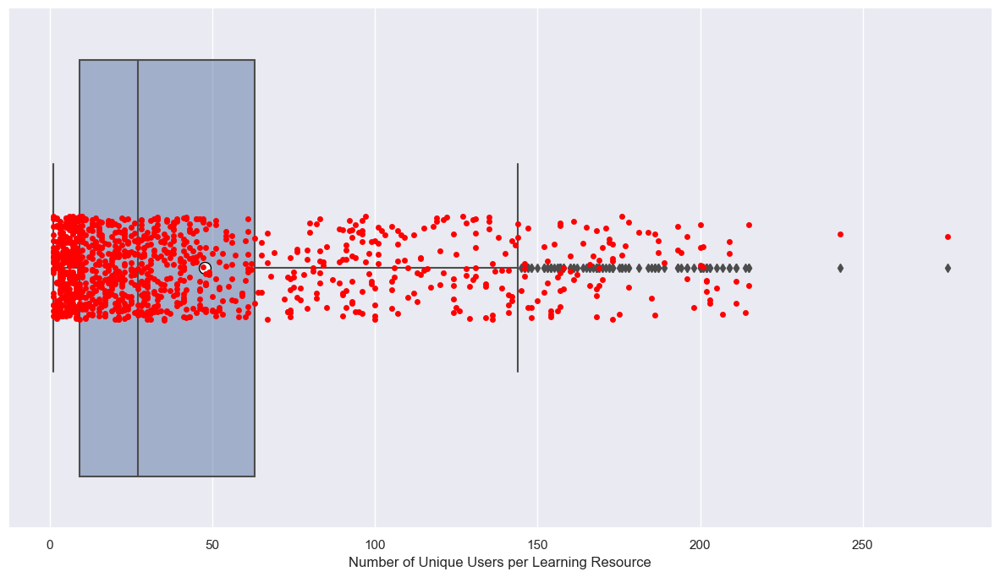

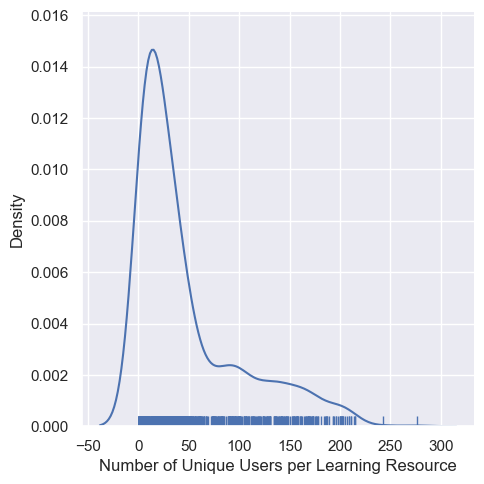

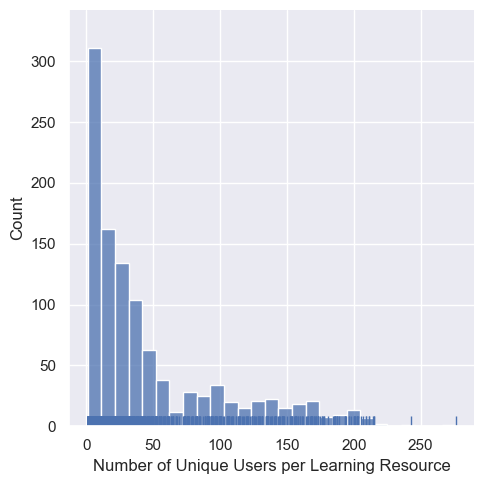

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Topics per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per Learning Resource: 1.1125461254612545
median: Number of Unique Topics per Learning Resource: 1.0
max: Number of Unique Topics per Learning Resource: 4
min: Number of Unique Topics per Learning Resource: 1
std: Number of Unique Topics per Learning Resource: 0.3248259320679144
iqr: Number of Unique Topics per Learning Resource: 0.0


Plots:


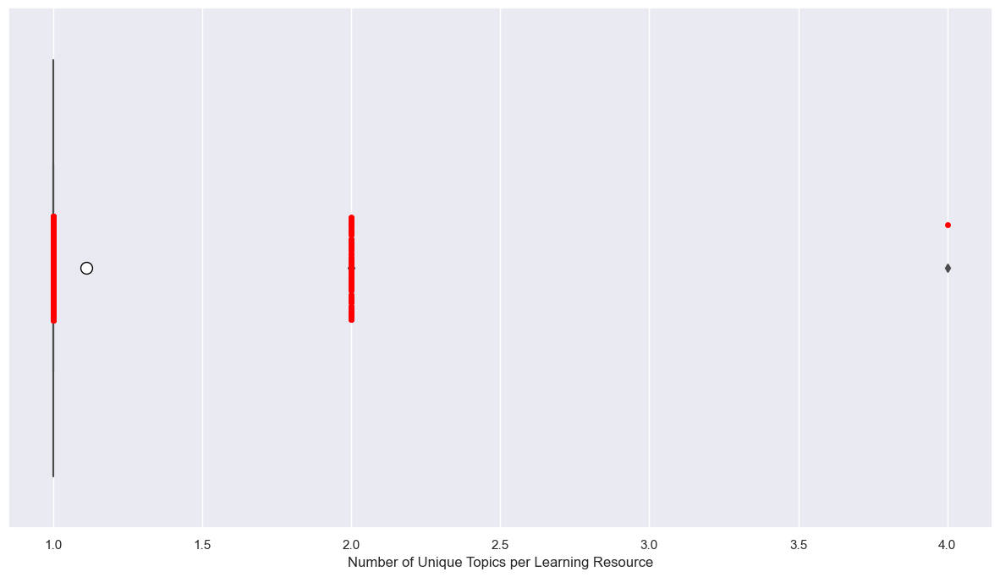

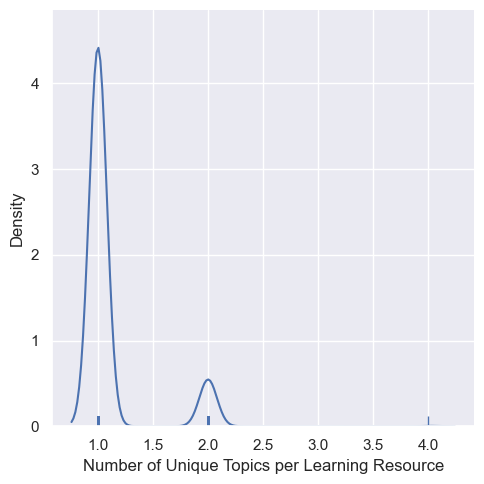

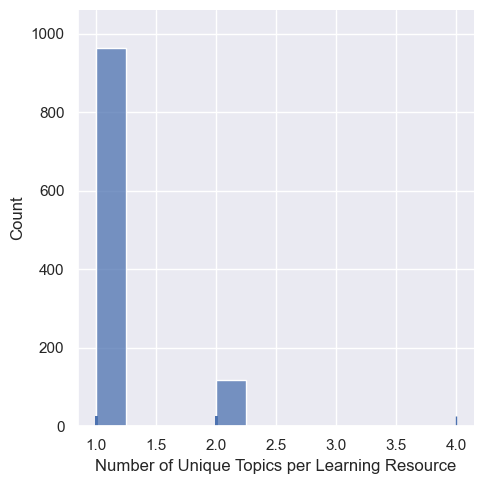

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per Topic for a User: 4.325950608644833
median of Mean Number of Interactions per Topic for a User: 4.351494934519398
max of Mean Number of Interactions per Topic for a User: 12.5
min of Mean Number of Interactions per Topic for a User: 1.0
std of Mean Number of Interactions per Topic for a User: 1.6443632595351245
iqr of Mean Number of Interactions per Topic for a User: 1.9009090909090909

____________________________________________________________________________________________________

mean 

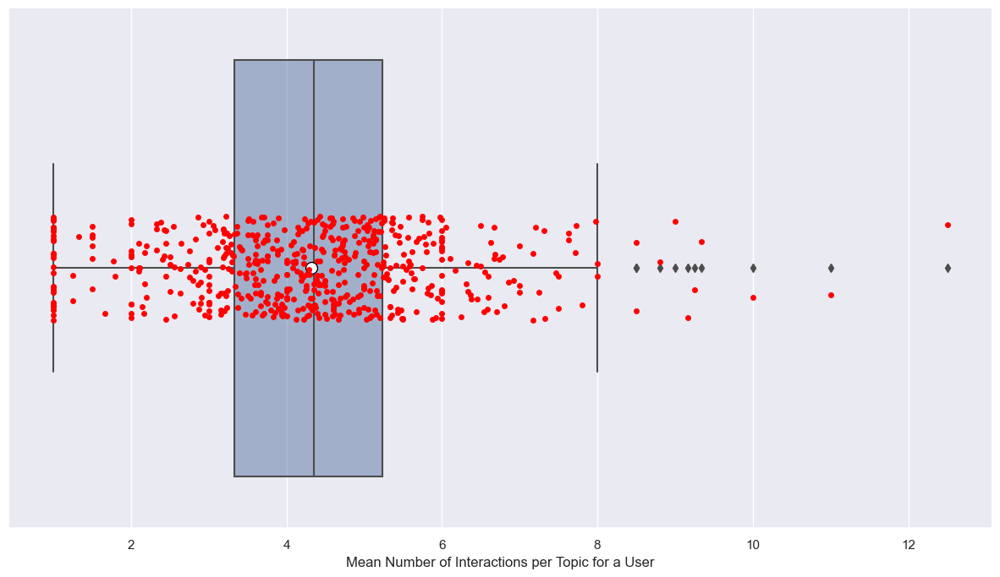

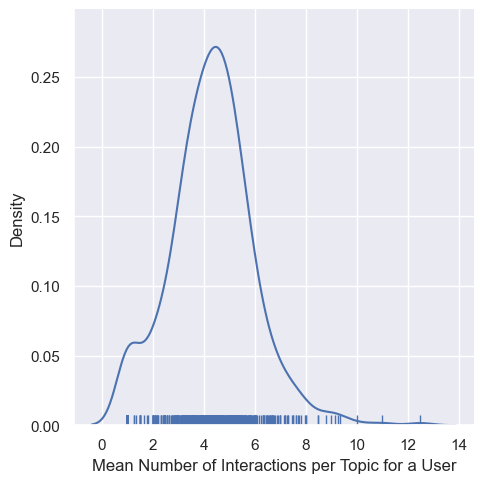

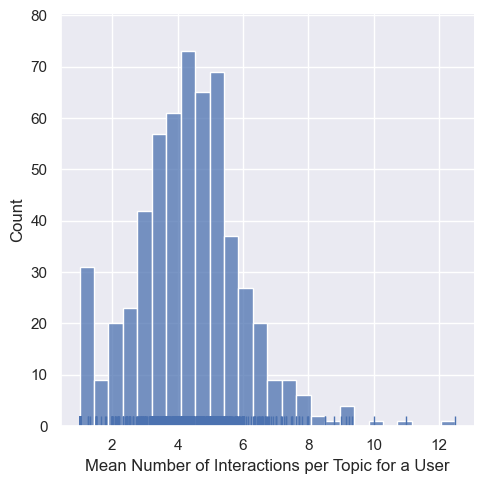



Median:


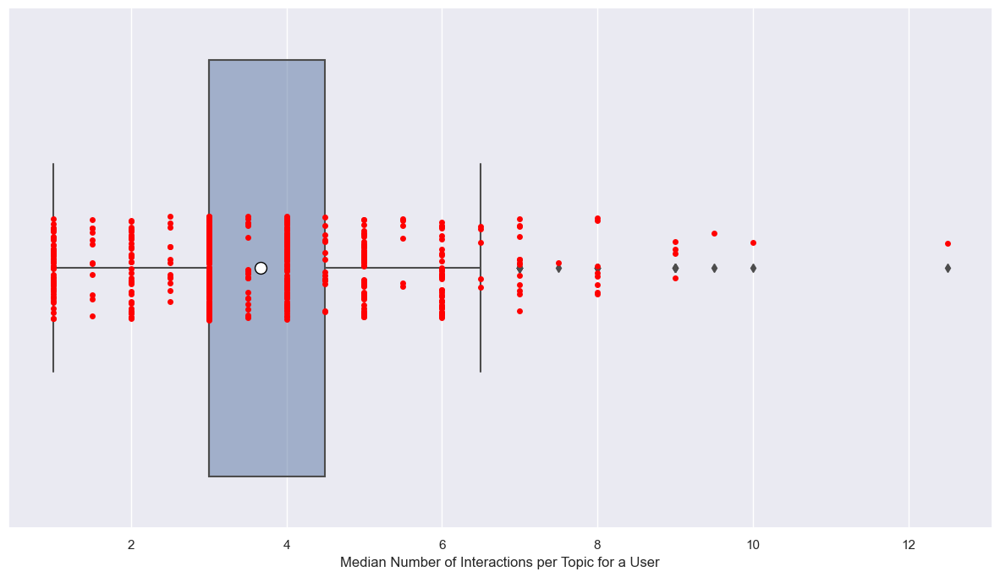

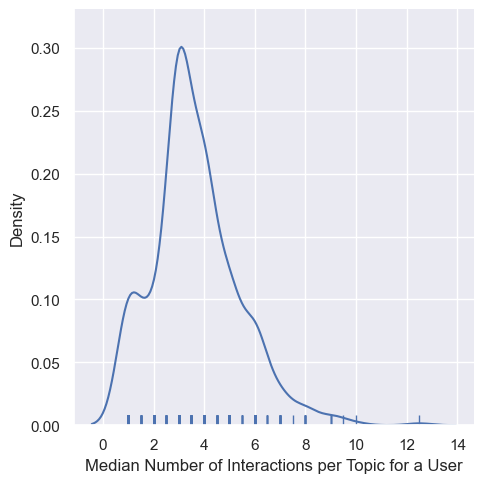

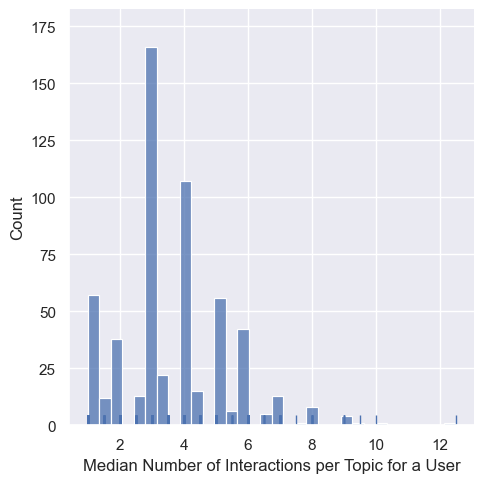

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per User for a Topic: 5.219579824718523
median of Mean Number of Interactions per User for a Topic: 4.597418244406196
max of Mean Number of Interactions per User for a Topic: 23.857142857142858
min of Mean Number of Interactions per User for a Topic: 1.0
std of Mean Number of Interactions per User for a Topic: 3.906070603854954
iqr of Mean Number of Interactions per User for a Topic: 4.9111402263513515

______________________________________________________________________________________________

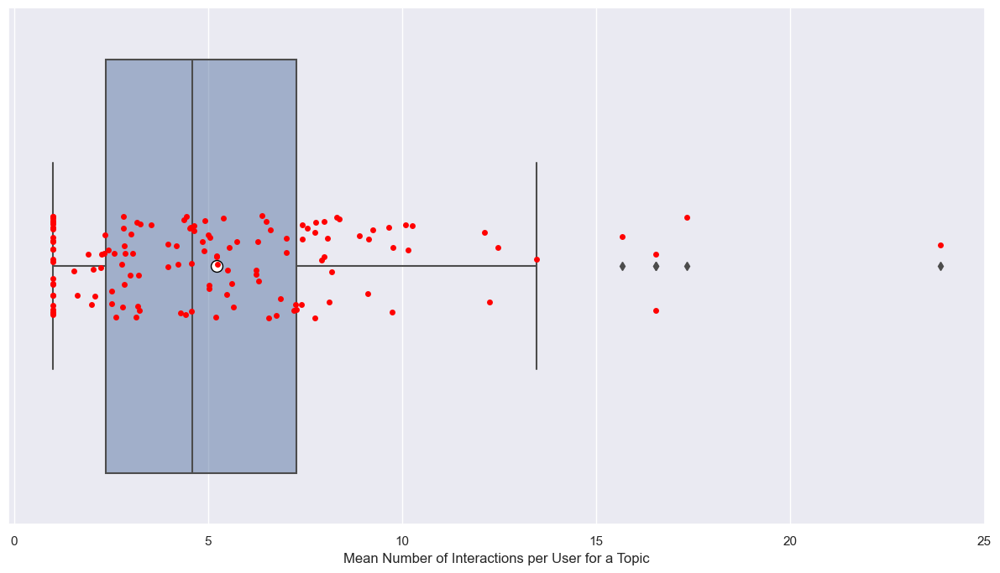

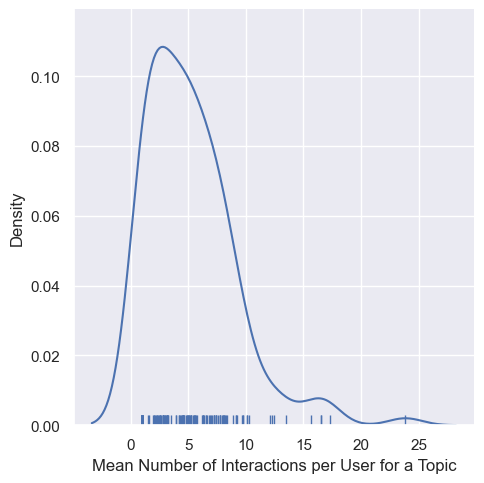

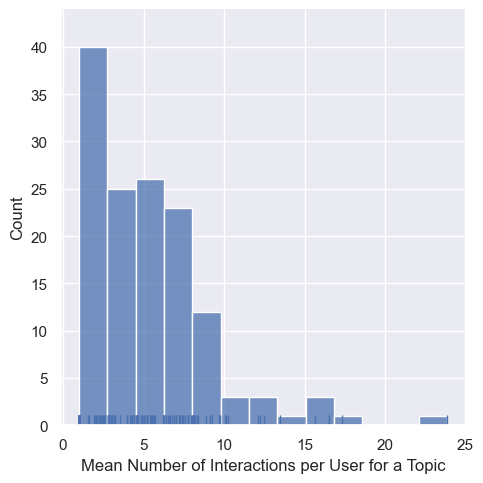



Median:


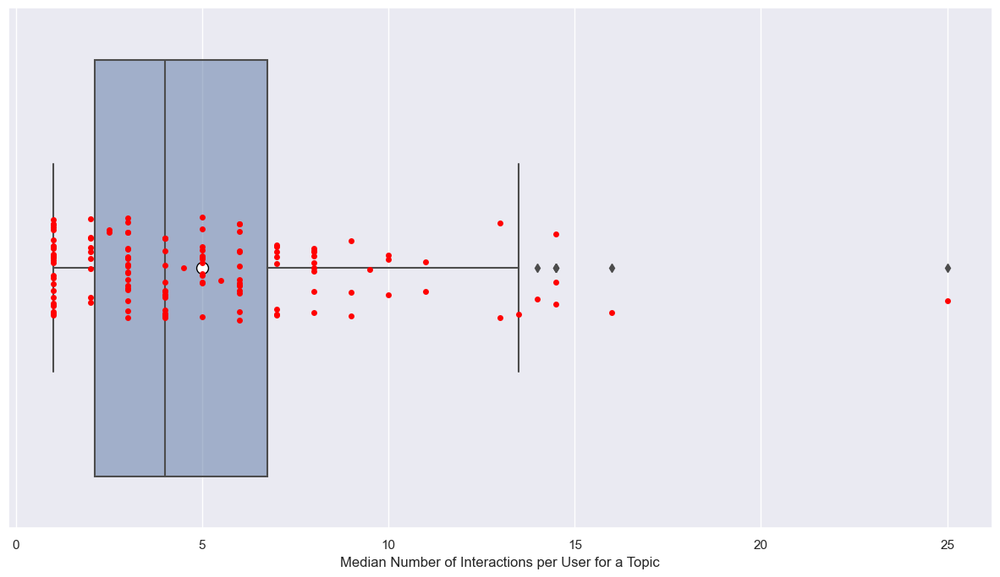

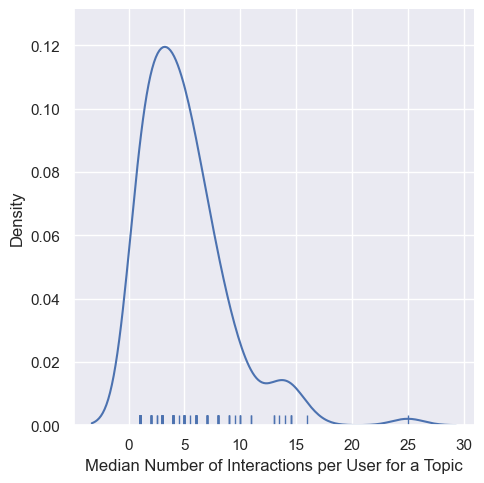

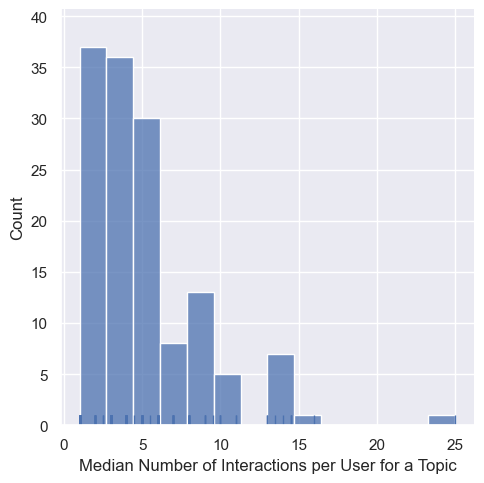

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per Topic for a User: 3.616728905690798
median of Mean Number of Unique Learning Resources per Topic for a User: 3.6666666666666665
max of Mean Number of Unique Learning Resources per Topic for a User: 9.333333333333334
min of Mean Number of Unique Learning Resources per Topic for a User: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per Topic for a User: 2.966

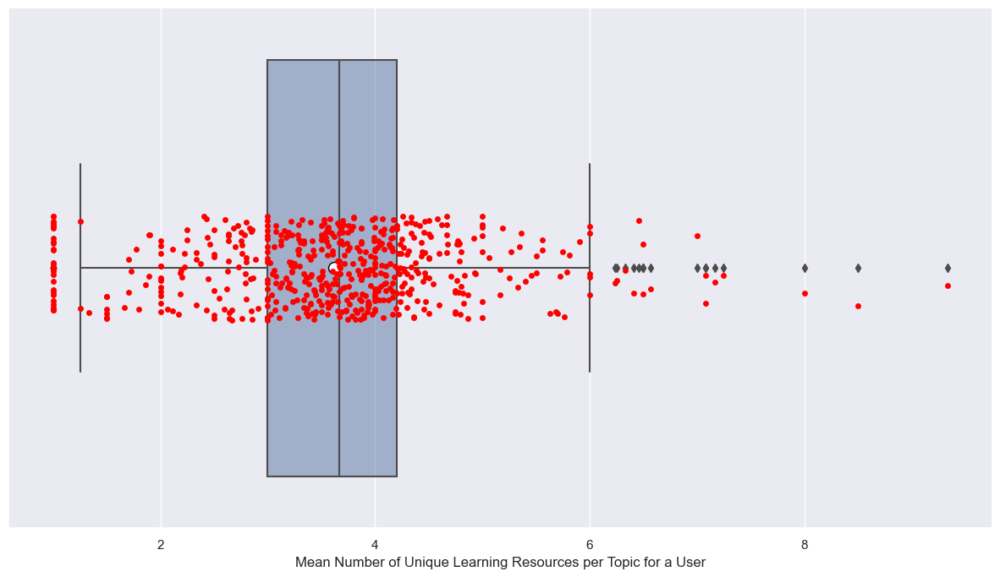

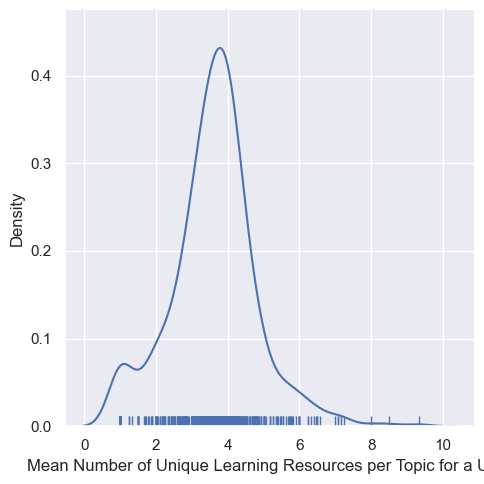

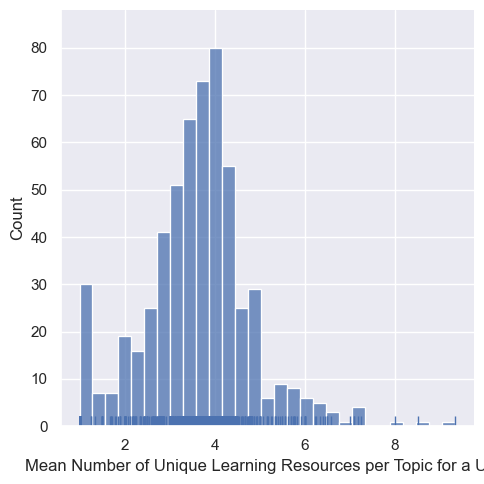



Median:


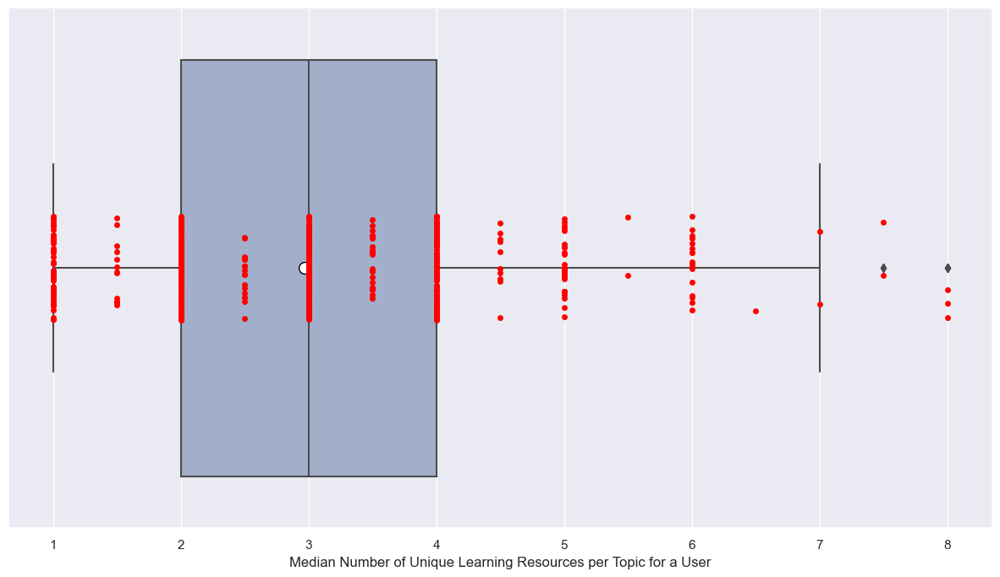

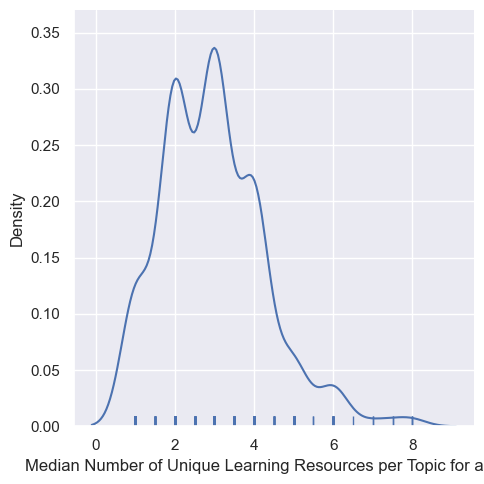

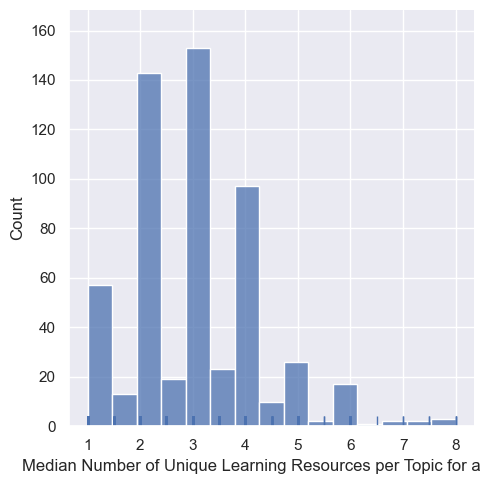

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per User for a Topic: 4.418529144593096
median of Mean Number of Unique Learning Resources per User for a Topic: 3.9530083443126918
max of Mean Number of Unique Learning Resources per User for a Topic: 16.49411764705882
min of Mean Number of Unique Learning Resources per User for a Topic: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per User for a Topic: 4.463

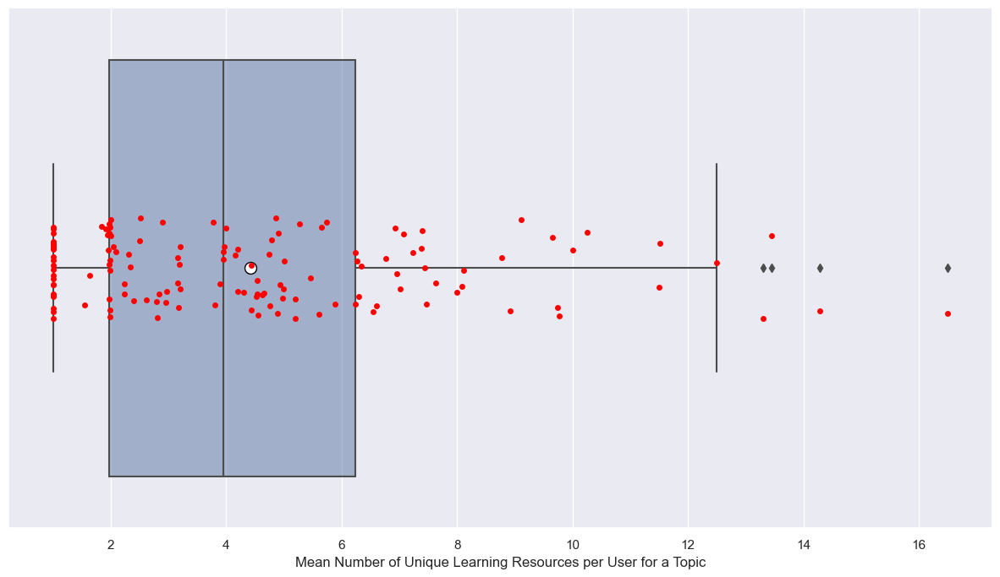

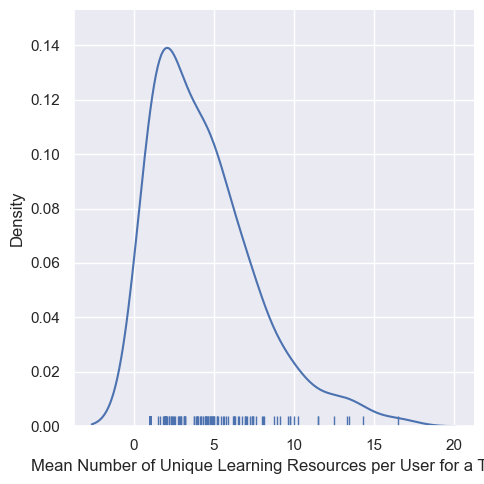

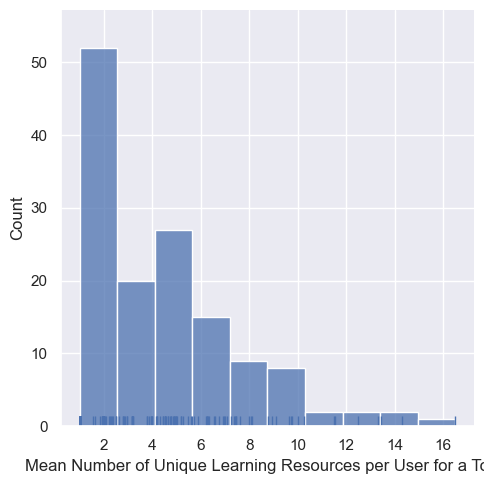



Median:


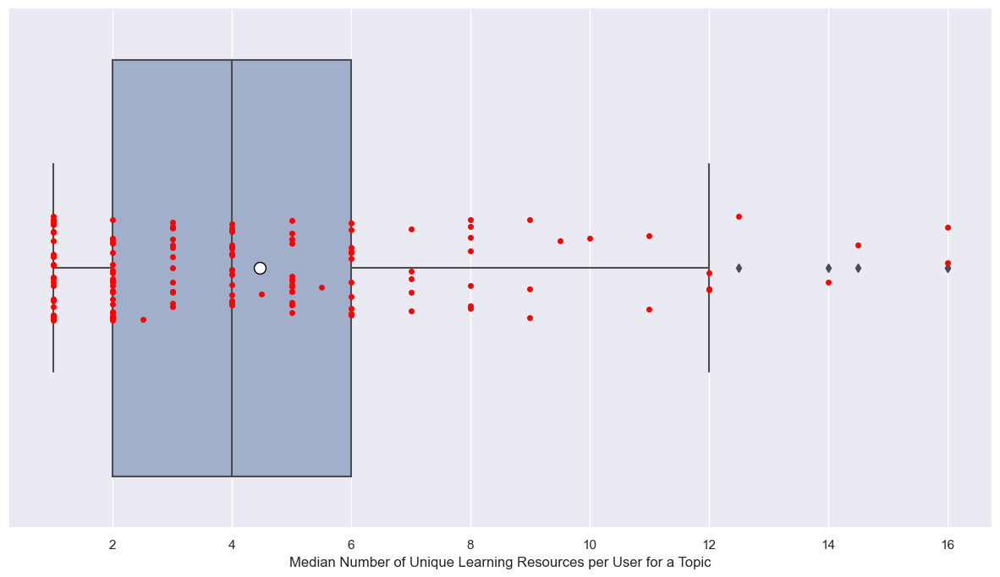

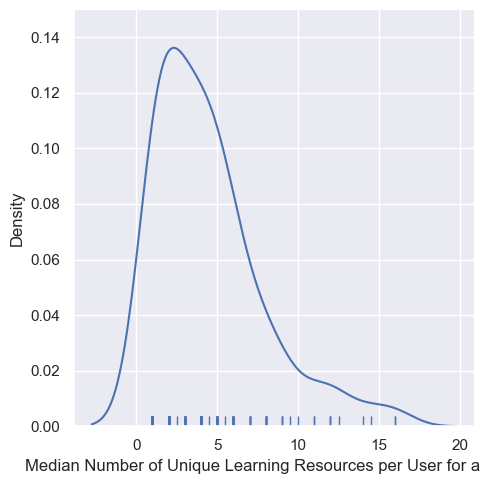

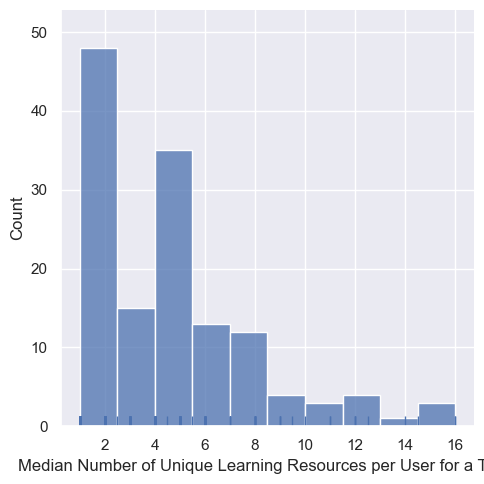

****************************************************************************************************
****************************************************************************************************
 


In [30]:
print_and_plot_group_user_learning_activity_relationship(interactions,
                                                         GROUP_FIELD_NAME_STR,
                                                         False)

## Unique Sequence Statistics

In [31]:
learning_activity_sequence_stats_per_group = return_learning_activity_sequence_stats_over_user_per_group(interactions,
                                                                                                         DATASET_NAME,
                                                                                                         GROUP_FIELD_NAME_STR, 
                                                                                                         USER_FIELD_NAME_STR, 
                                                                                                         LEARNING_ACTIVITY_FIELD_NAME_STR,
                                                                                                         TIMESTAMP_FIELD_NAME_STR)

In [32]:
pickle_write(learning_activity_sequence_stats_per_group,
             PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

### Unique Sequence Statistics

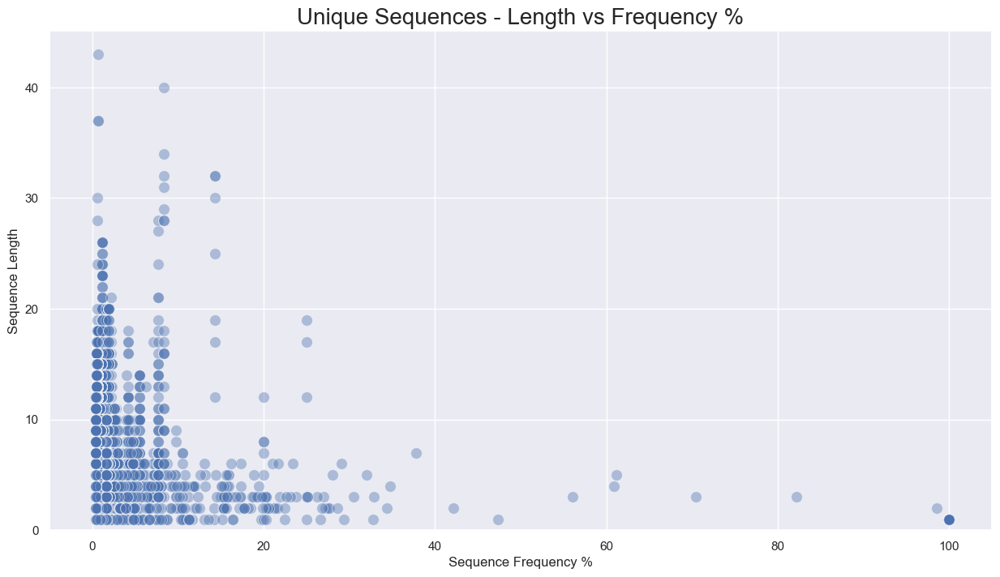

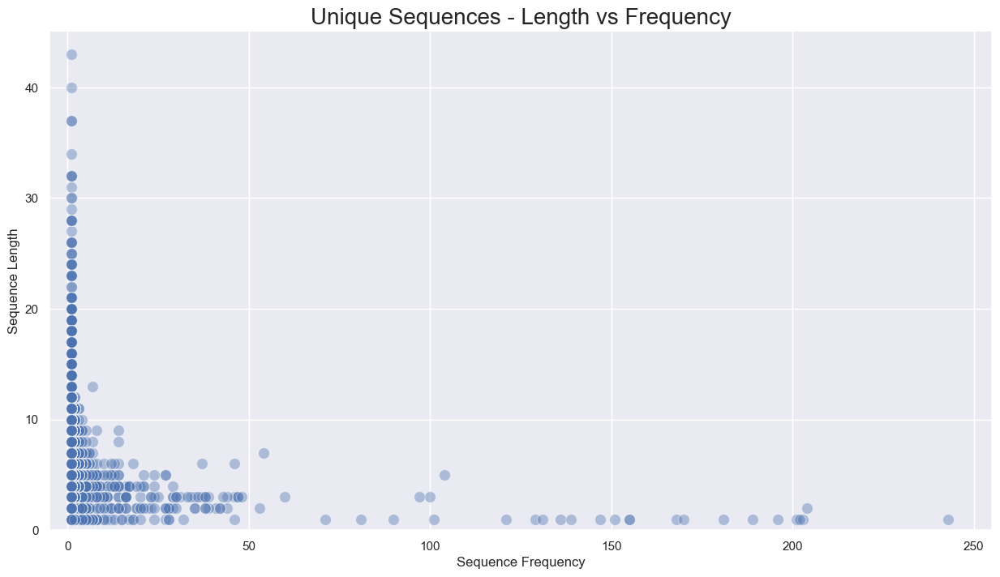

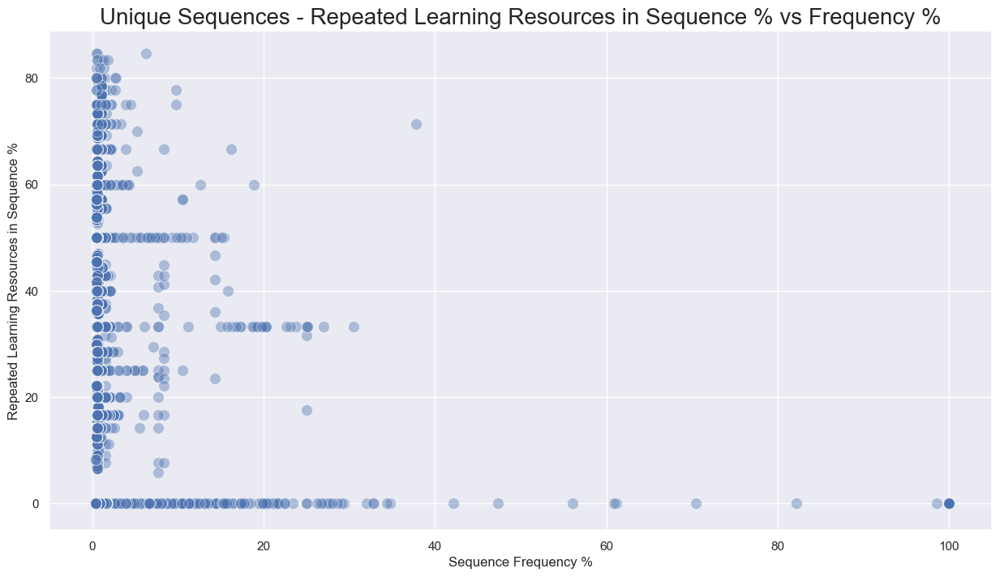

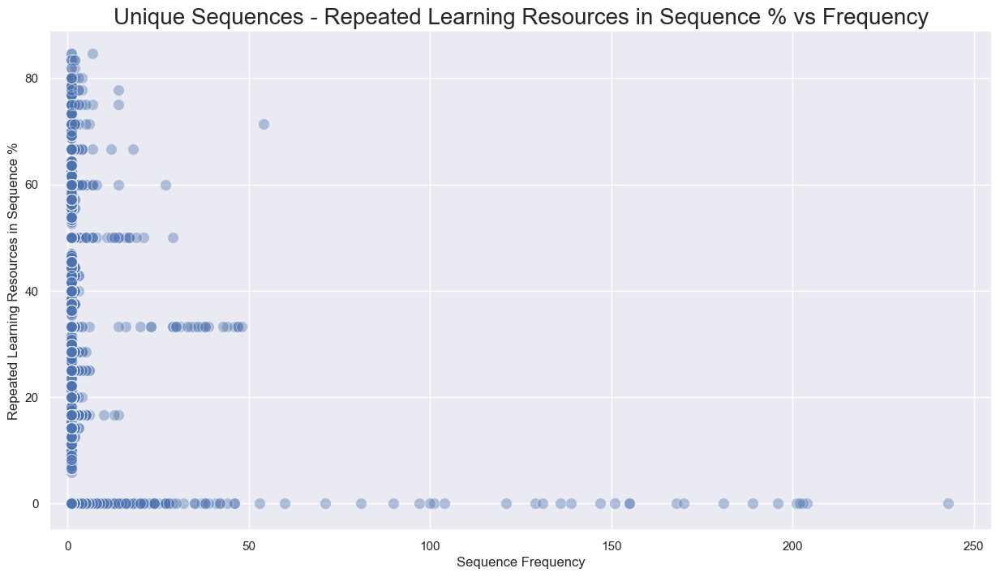

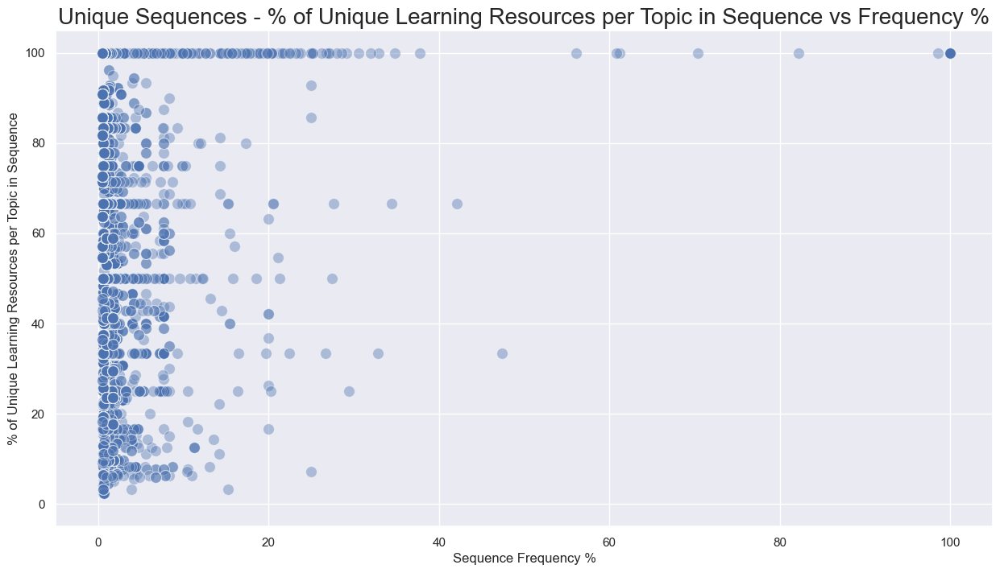

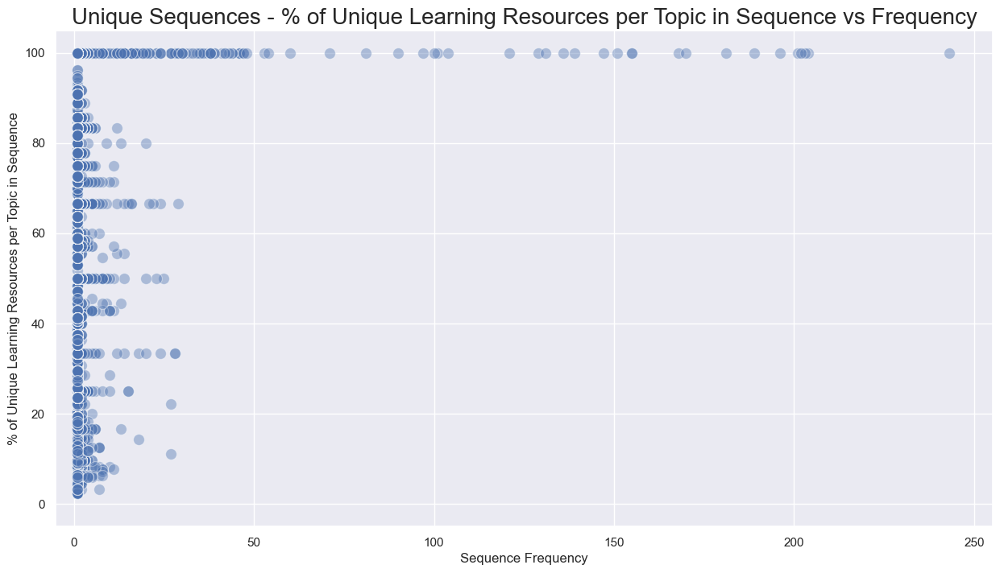

In [33]:
plot_sequence_stats(learning_activity_sequence_stats_per_group)

### Unique Sequence Statistics per Group

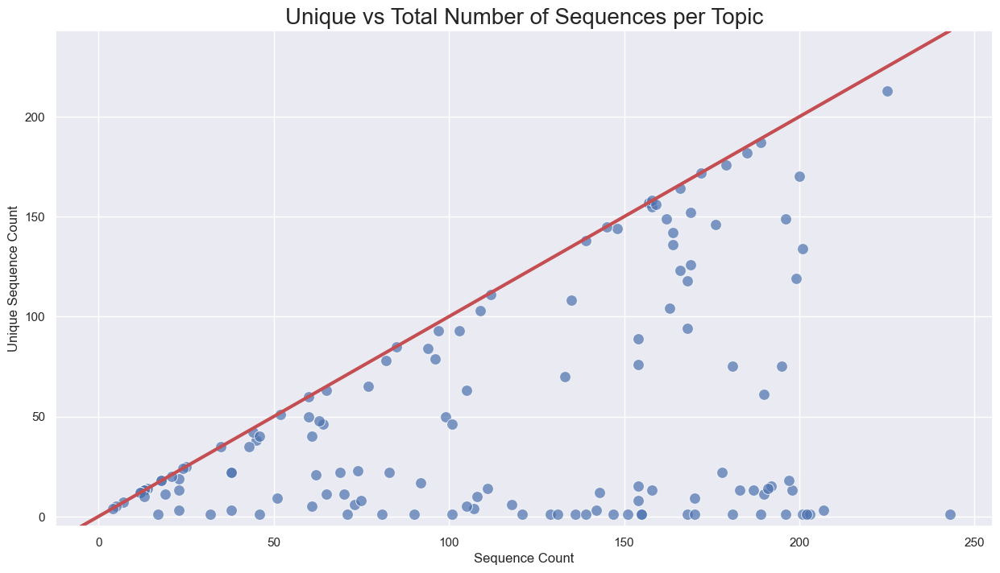

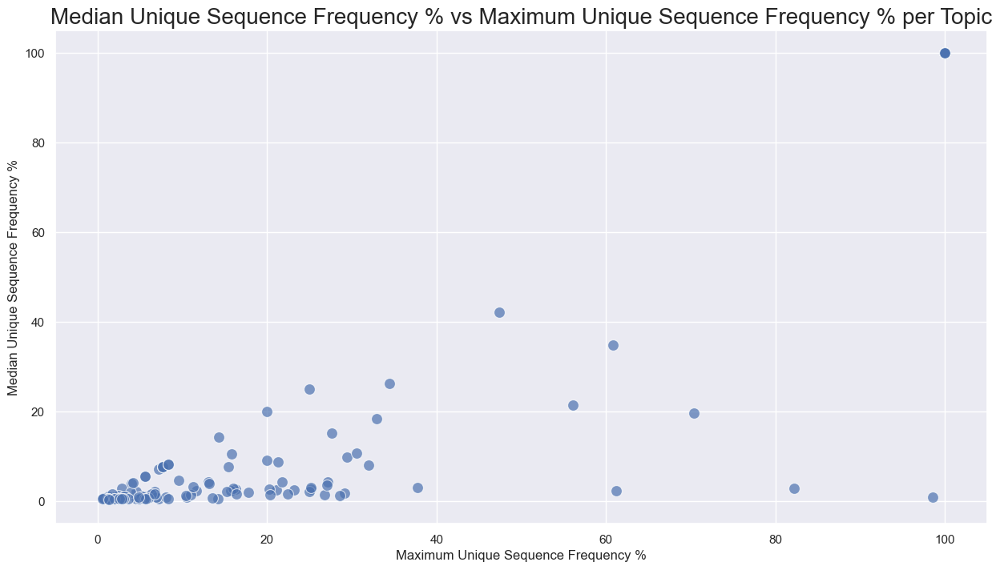

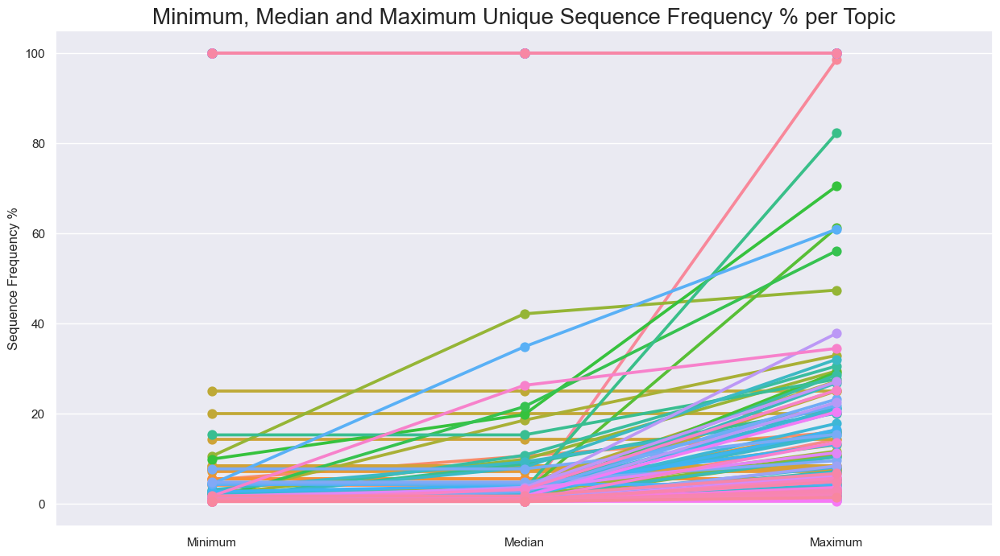

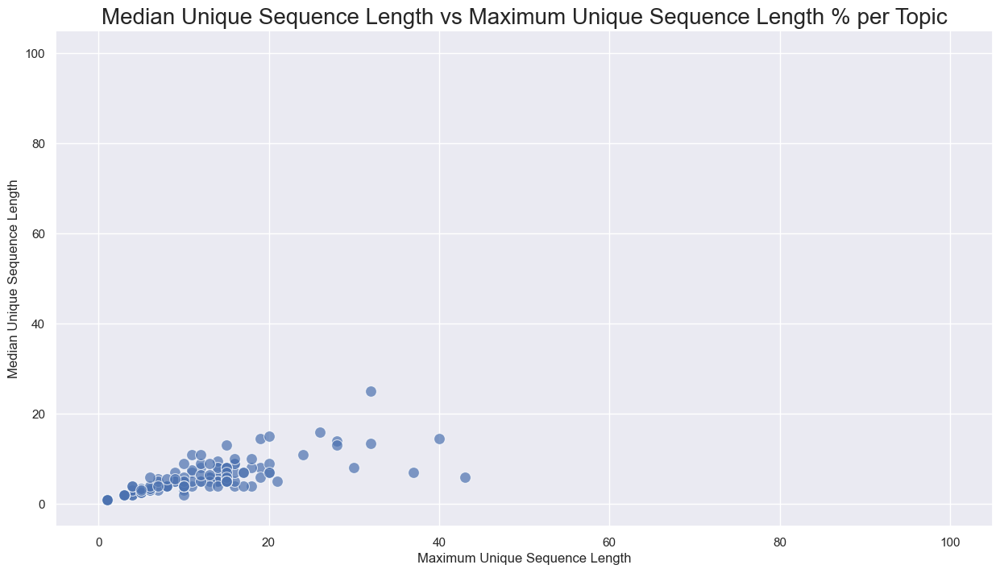

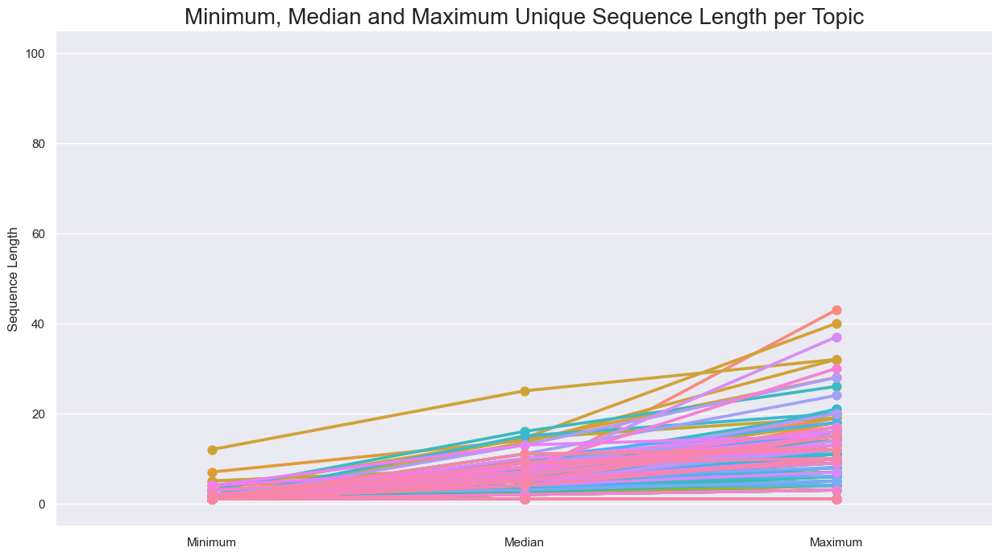

...

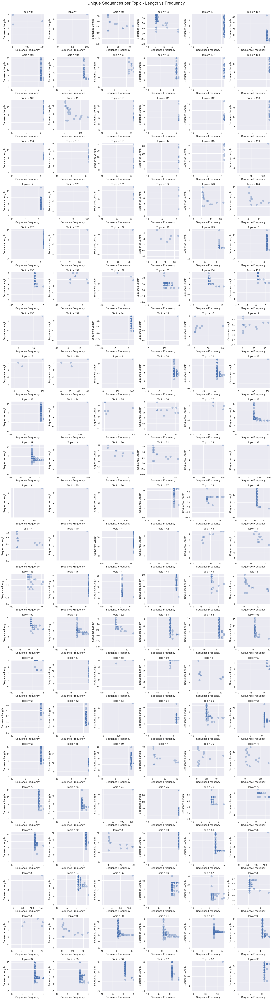

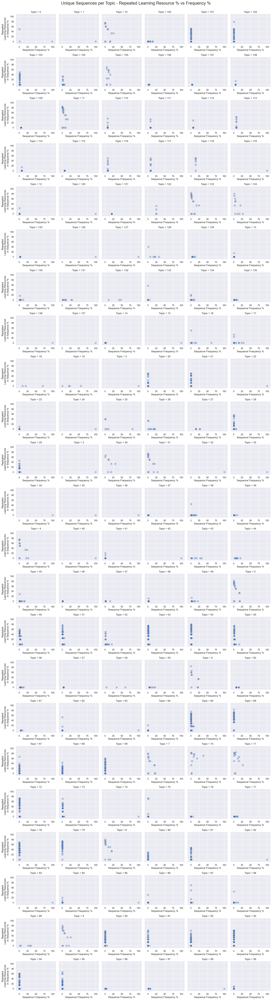

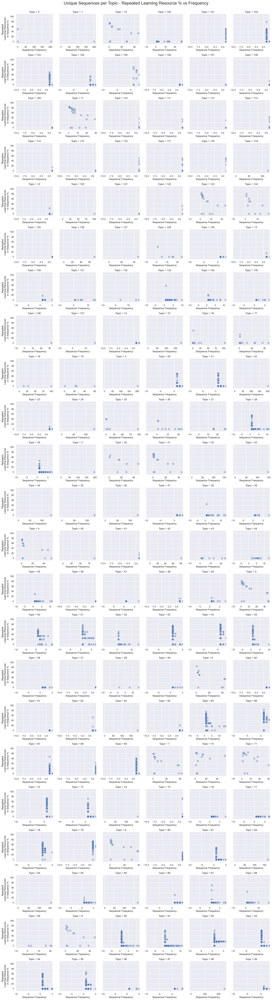

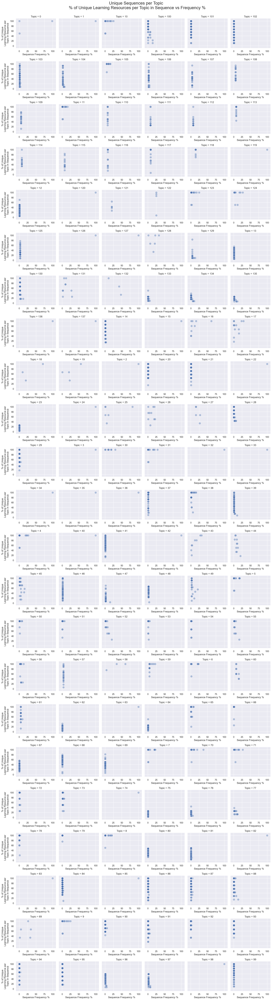

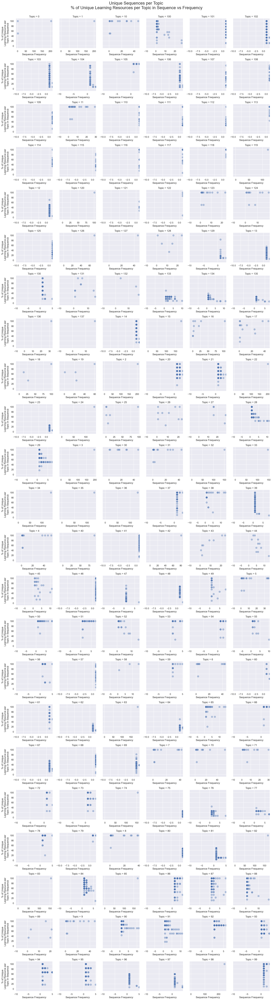

In [34]:
plot_sequence_stats_per_group(learning_activity_sequence_stats_per_group,
                              GROUP_FIELD_NAME_STR)

## Sequence Distance

In [56]:
topic_filter = interactions.groupby(GROUP_FIELD_NAME_STR)[USER_FIELD_NAME_STR].nunique().sort_values() > 80
topic_filter = topic_filter[topic_filter]
topic_filter = list(topic_filter.index)
interactions = interactions.loc[interactions[GROUP_FIELD_NAME_STR].isin(topic_filter), :]

In [35]:
seq_distances = calculate_sequence_distances(interactions, 
                                             USER_FIELD_NAME_STR, 
                                             GROUP_FIELD_NAME_STR, 
                                             LEARNING_ACTIVITY_FIELD_NAME_STR, 
                                             SEQUENCE_ID_FIELD_NAME_STR)

--------------------
Topic-Field Available:
Calulate Sequence Distances for each Topic
--------------------
--------------------------------------------------
Total number of Topic: 138
--------------------------------------------------
--------------------------------------------------
Final number of Topics: 138
Final number of Users: 568
Final number of interactions: 71972
--------------------------------------------------


100%|██████████| 138/138 [00:03<00:00, 45.47it/s]

--------------------------------------------------
Duration in seconds: 3.227383852005005
--------------------------------------------------


In [36]:
pickle_write(seq_distances,
             PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

100%|██████████| 138/138 [00:00<00:00, 1130.42it/s]


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


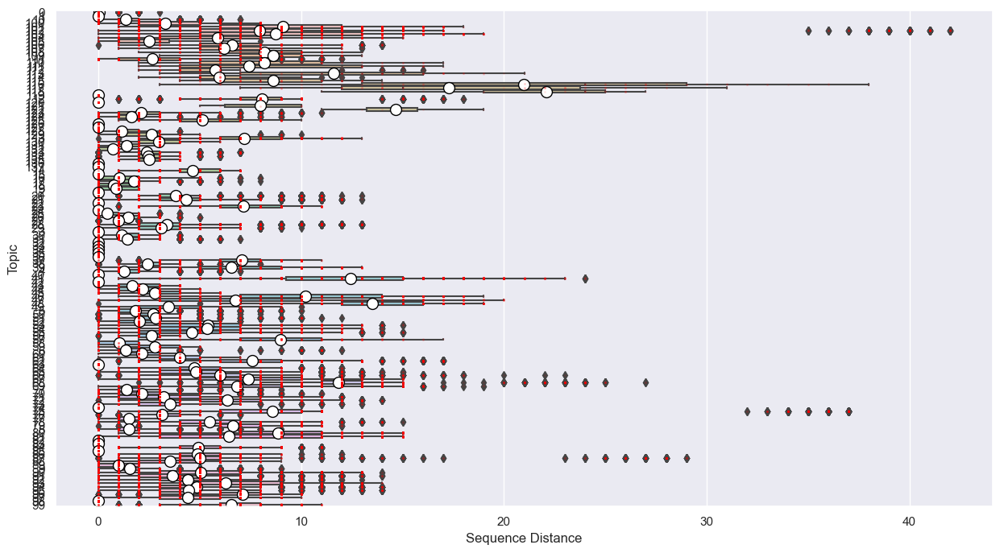

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


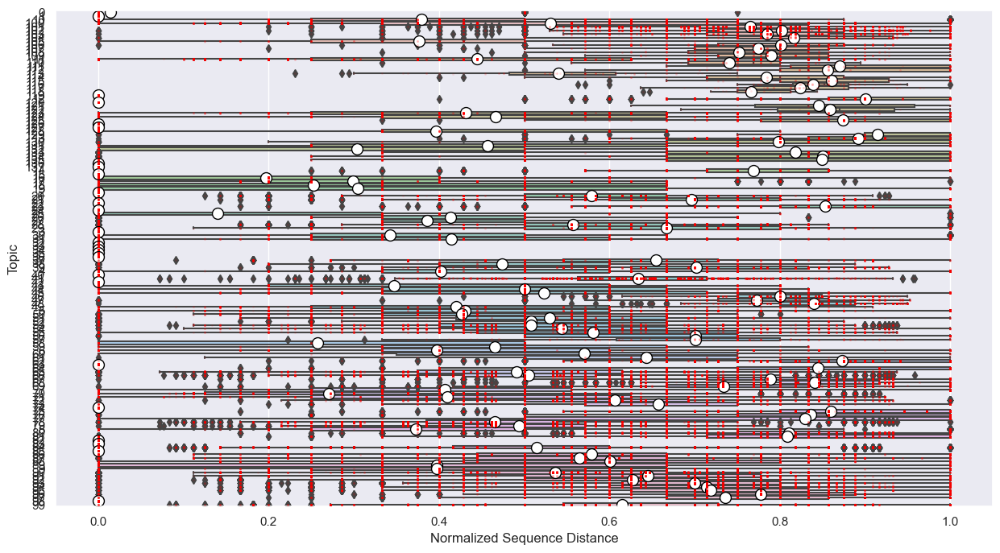

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


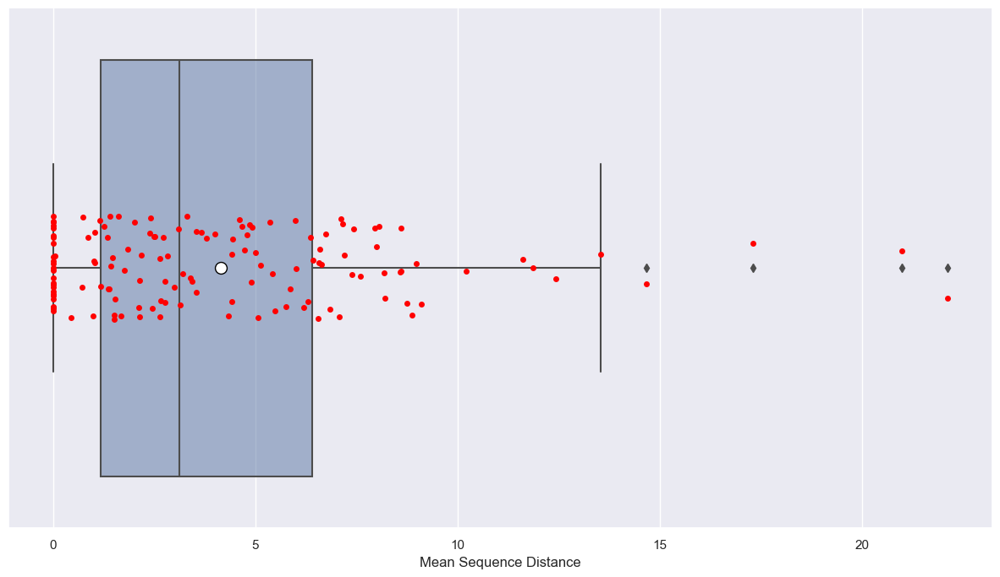

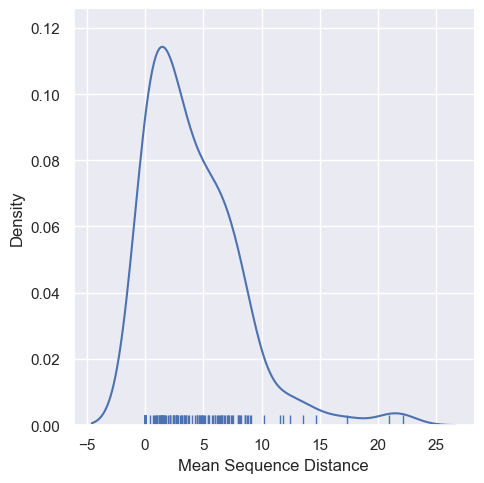

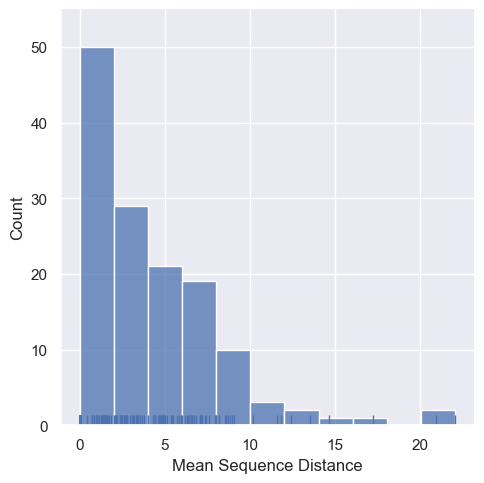

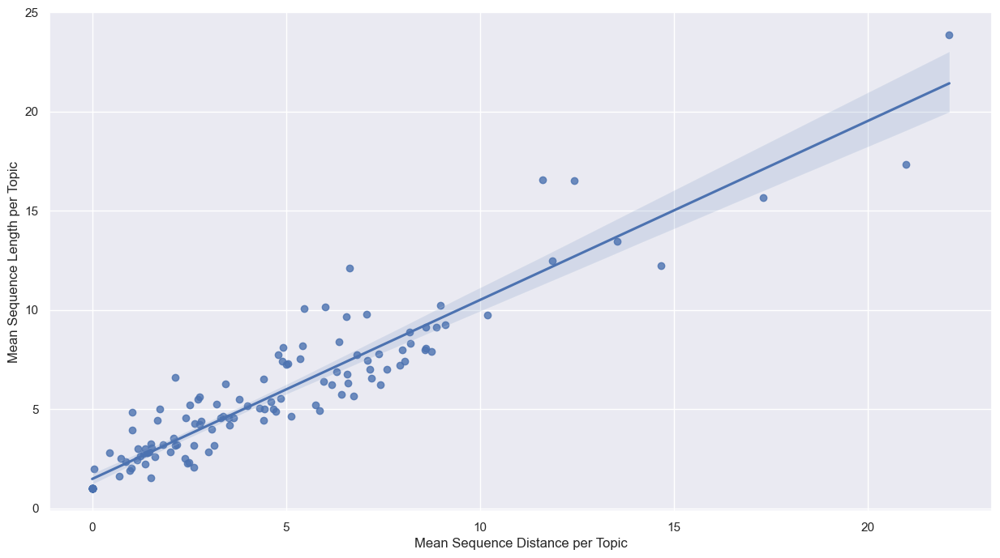

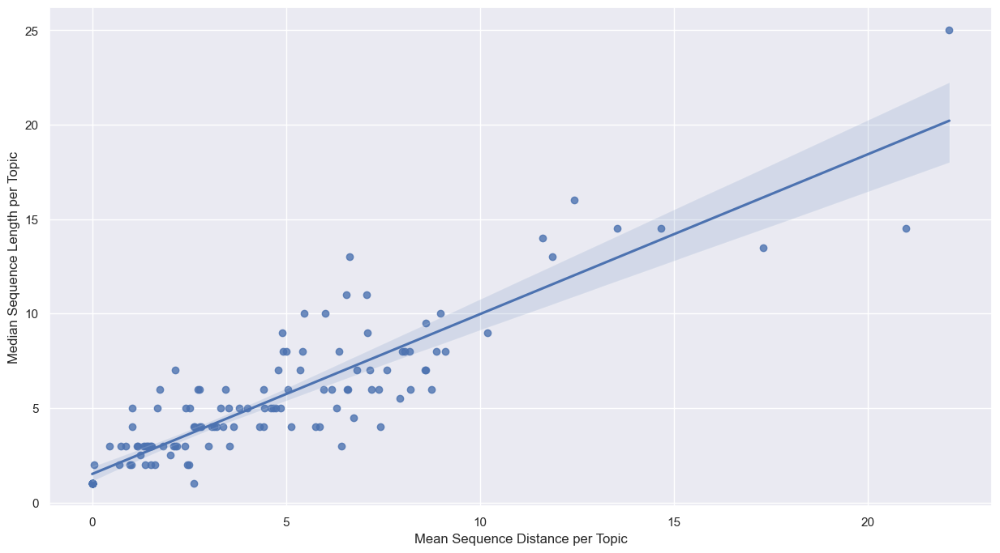

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


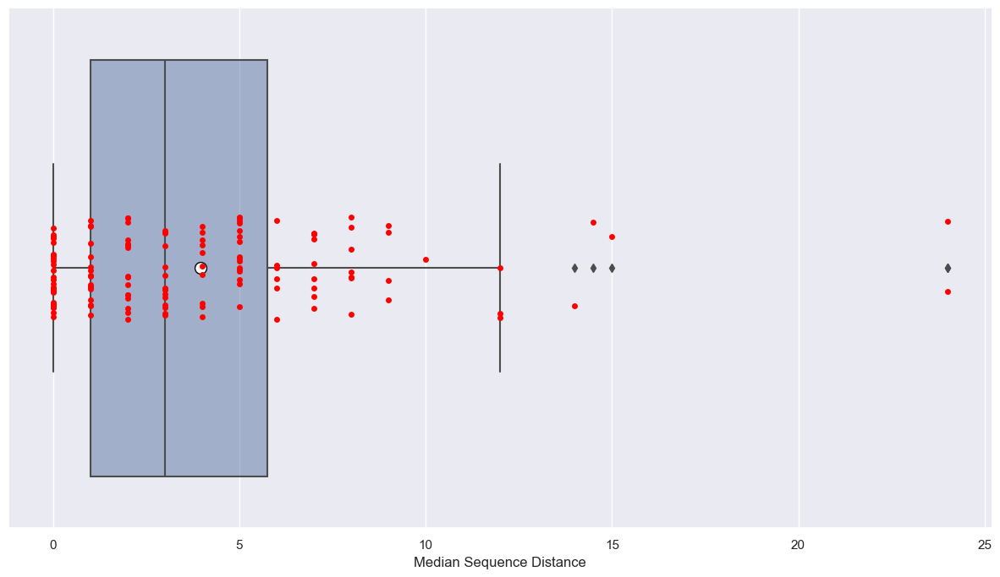

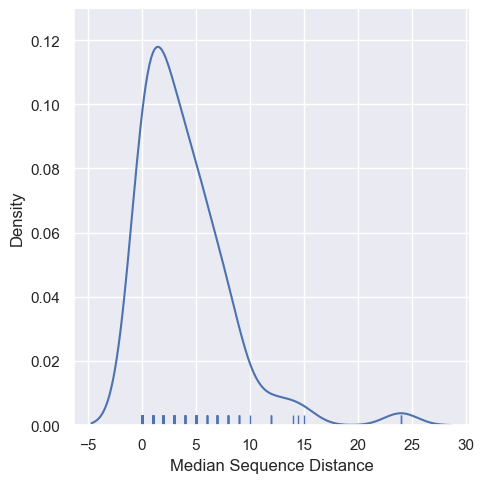

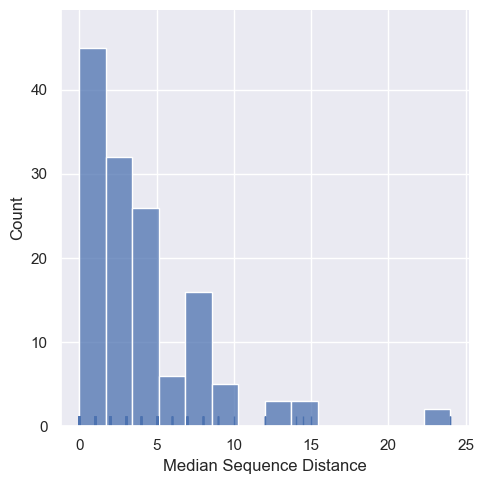

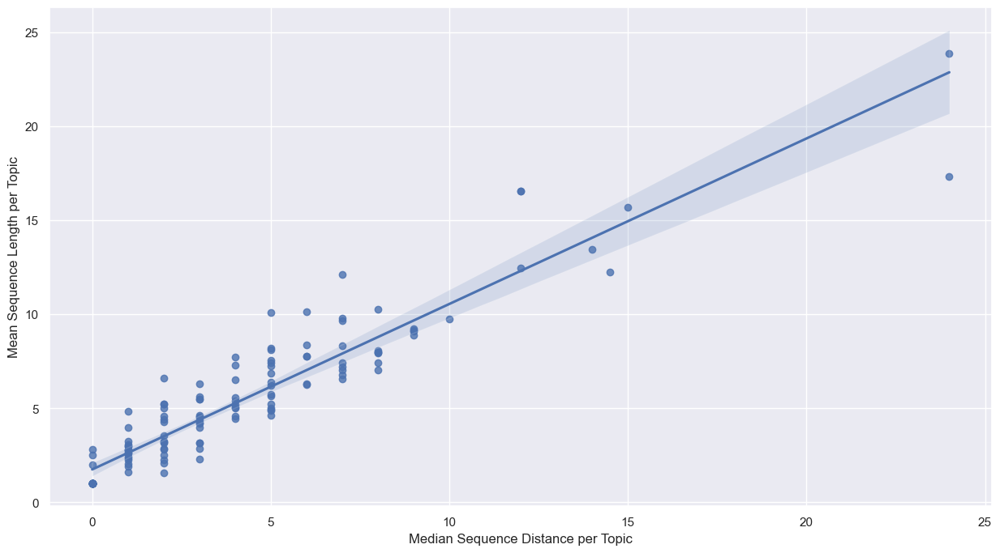

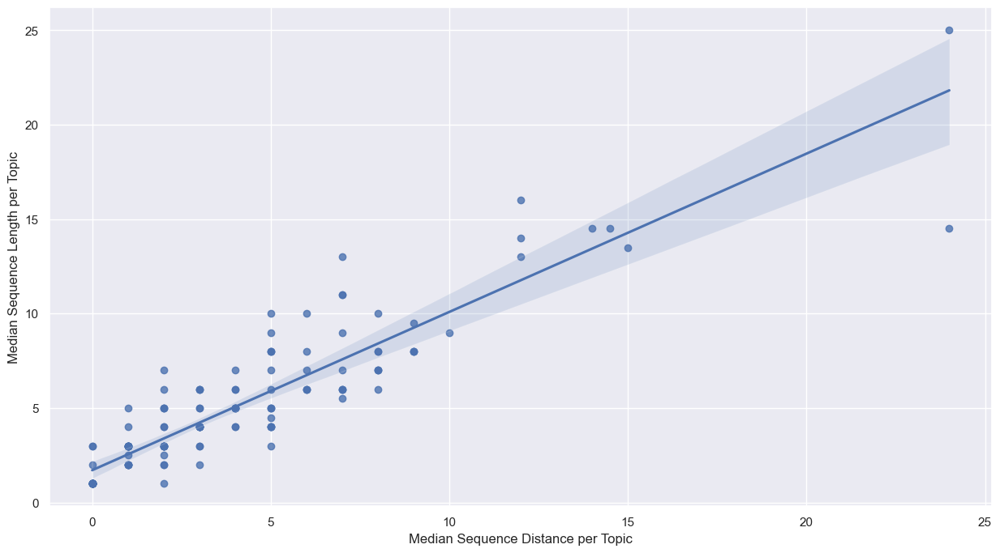

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


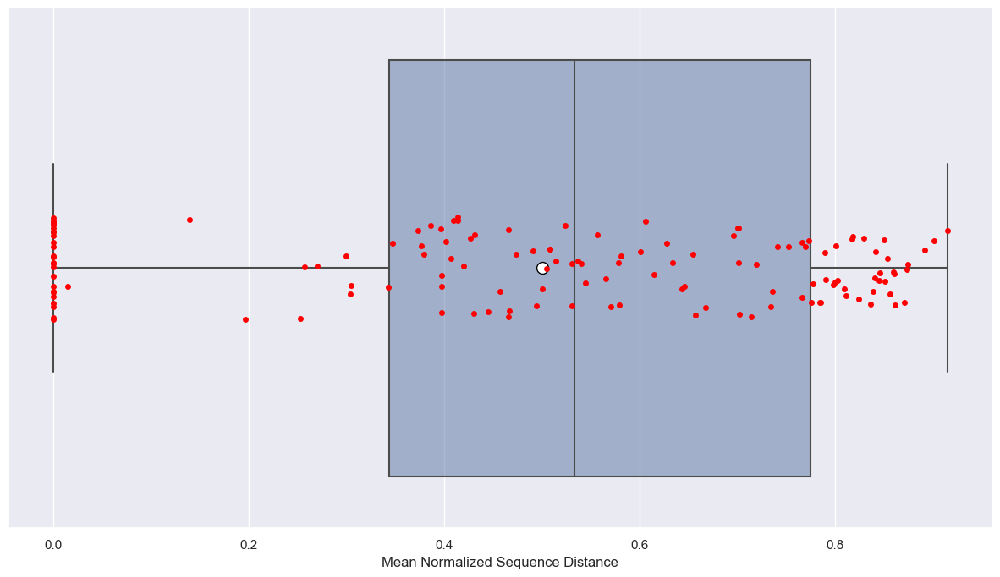

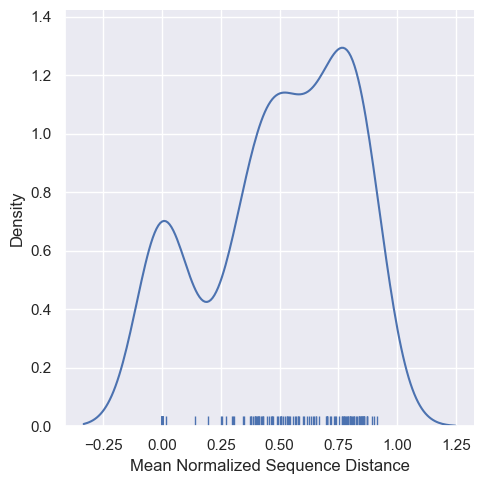

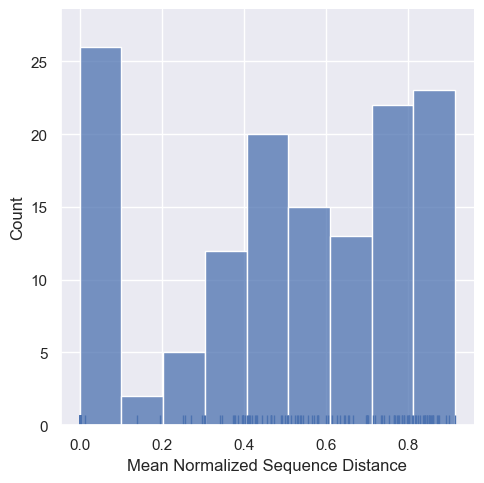

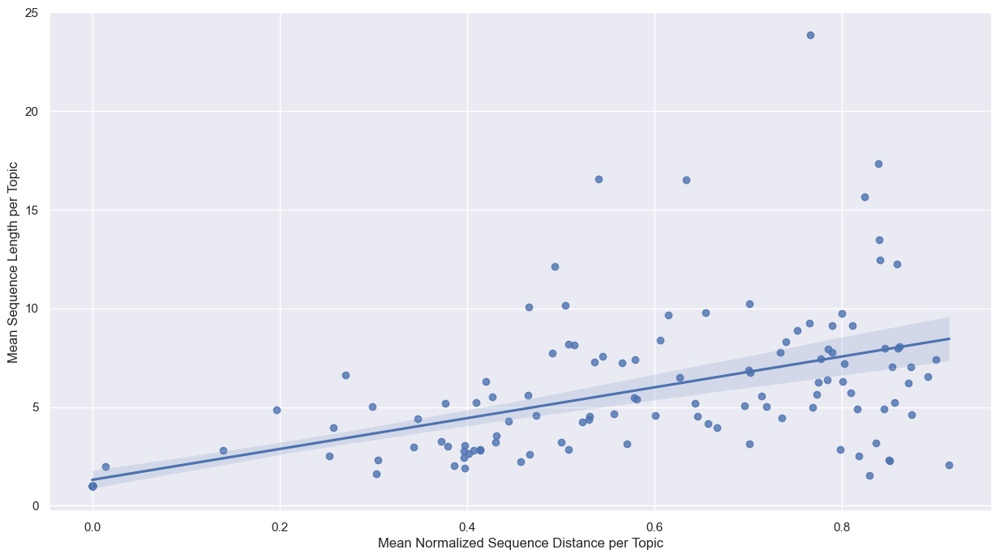

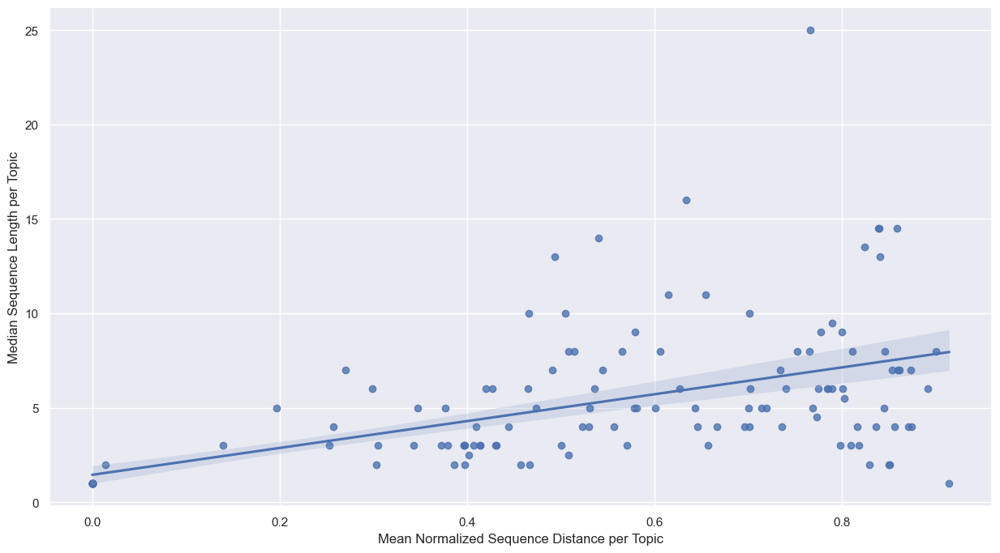

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


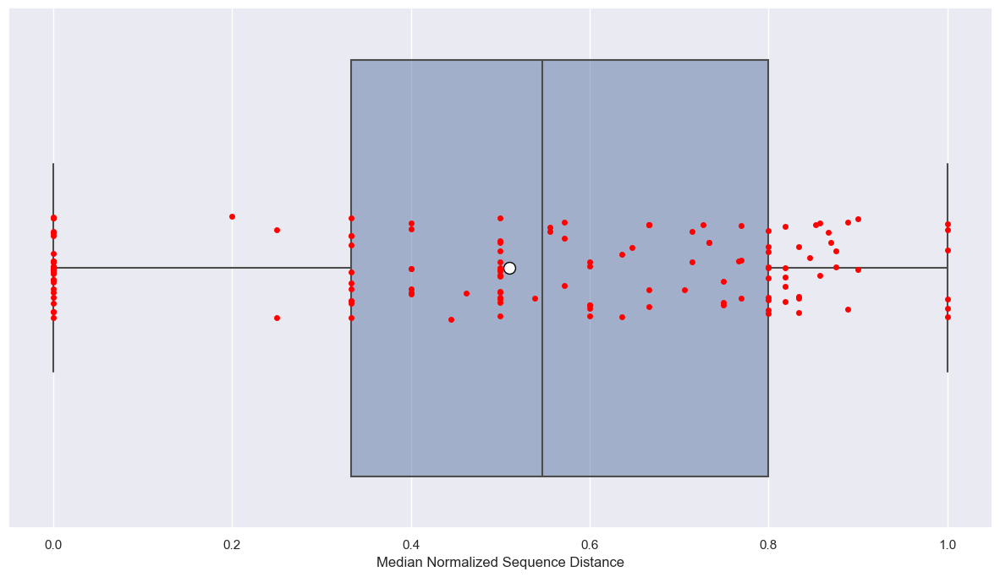

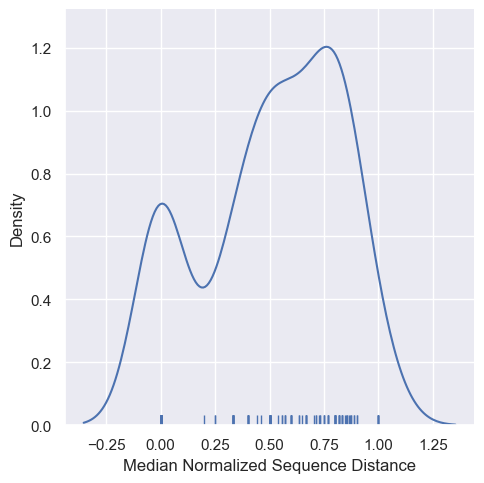

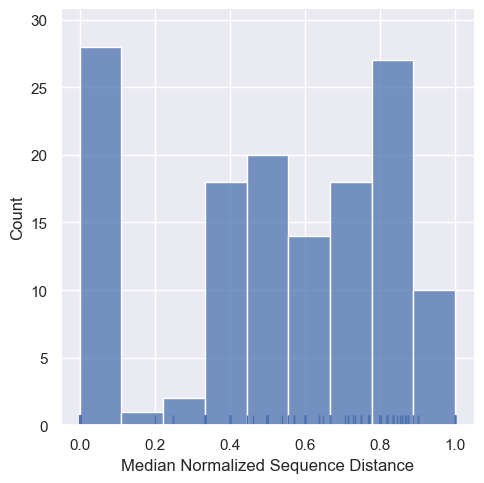

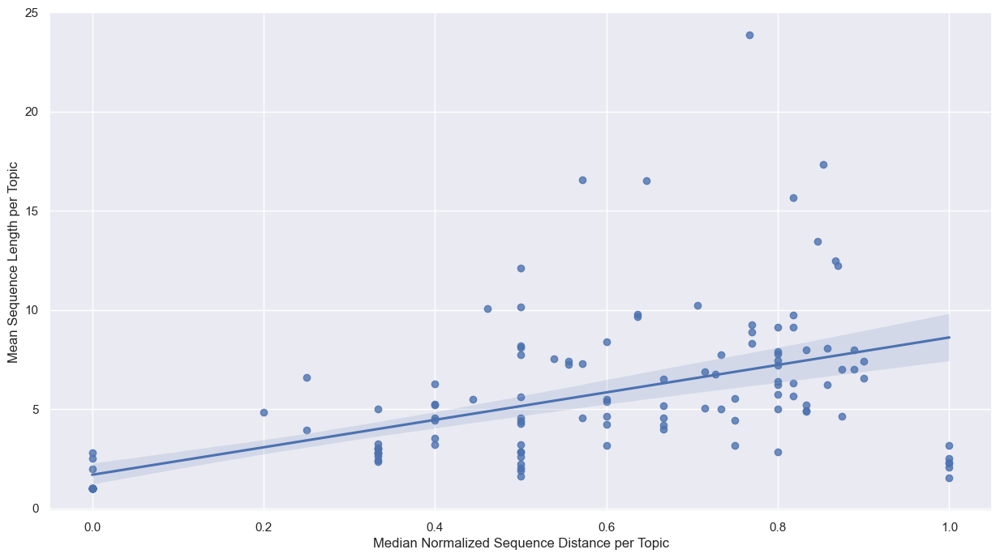

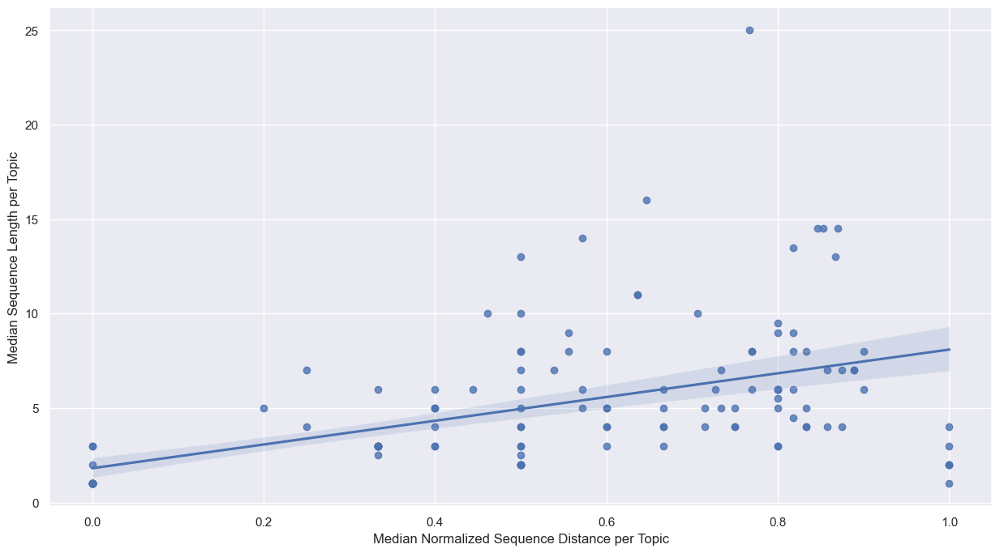

****************************************************************************************************
****************************************************************************************************
 


In [37]:
plot_sequence_distances(seq_distances)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


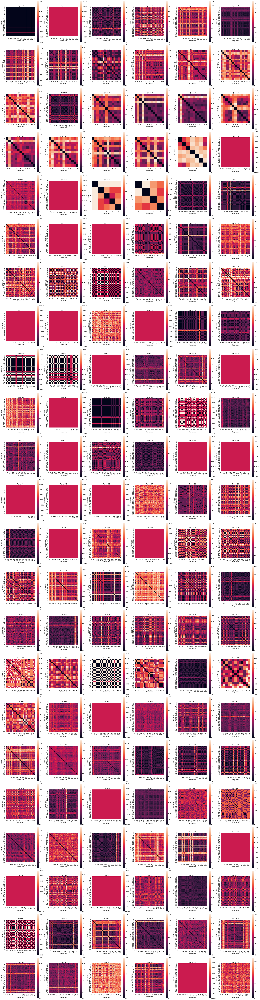

In [ ]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        False,
                                        5)

c:\Users\sschmerda\Desktop\DDIA\Repo\ddia\sequence_sim_eda_datasets\code\dataset_analysis_new\utilities\sequence_distance_analysis.py:227: RuntimeWarning: invalid value encountered in true_divide
  distances = distances / max_sequence_len_per_distance


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


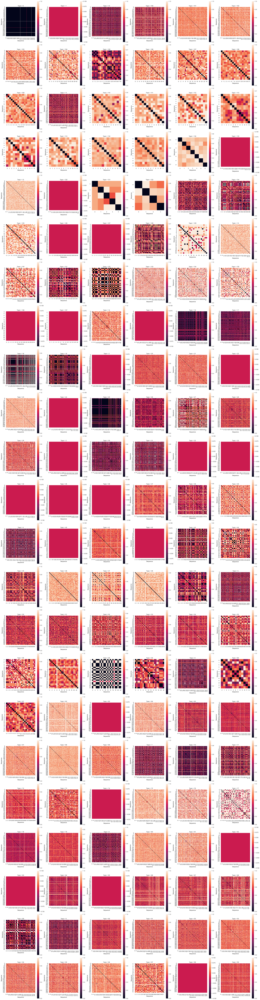

In [ ]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        True,
                                        5)

## Clustering of Sequence Distances and Testing for Evaluation Metric Central Tendency Differences between Clusters 

In [ ]:

                      (USER_FIELD_NAME_STR, GROUP_FIELD_NAME_STR, NUMBER_UNIQUE_USERS_PER_GROUP_STR),
n_unique_var_per_group = print_and_return_unique_col2_per_col1(interactions, 
                                                                grouper, 
                                                                var, 
                                                                label)
        print('\n')
        print('Plots:')
        plot_distribution(n_unique_var_per_group,
                          label,
                          label,
                          log_scale)

In [ ]:

topic_filter = interactions.groupby(GROUP_FIELD_NAME_STR)[USER_FIELD_NAME_STR].nunique().sort_values() > 80
topic_filter = topic_filter[topic_filter]
topic_filter = list(topic_filter.index)
interactions = interactions.loc[interactions[GROUP_FIELD_NAME_STR].isin(topic_filter), :]

In [37]:
class ClusterEvaluation:
    """
    A class containing methods which perform several tasks:
        1. Calculation of sequence distance clusters for each group

        2. Performance of omnibus testing for central tendency differences in a specified evaluation metric
           between each cluster
            - Depending on normality and homoscedasticity of the evaluation metric in the clusters an appropriate test
              will be chosen: Anova vs Welch-Anova vs Kruskall-Wallis
        
        3. Performance of post-hoc tests for differences between single clusters of a group

        4. Calculation of sequence and cluster statistics for each group

        5. Plotting of cluster results and differneces in distribution of specified evaluation metric between clusters

    Parameters
    ----------
    dataset_name: str
        The name of the dataset.
    interactions: pd.DataFrame
        The interactions dataframe.
    user_field: str
        Then name of the user field.
    group_field: str
        Then name of the group field.
        This argument should be set to None if the interactions dataframe does not have a group_field.
    evaluation_field: str
        Then name of the evaluation metric field for which central tendency differences between clusters are being tested.
    sequence_distances_dict: dict
        A nested dictionary containing results of "get_user_sequence_distances_per_group" or "get_user_sequence_distances" methods\
        of SeqDist or SeqDistNoGroup for all available groups.
        For each group the subdictionary must contain the following keys: 
        ('Sequence Distance', 'Sequence Maximum Length', 'Sequence User Combination', 'User', 'Sequence Length', 'Sequence ID', 'Sequence Array').
    use_normalized_sequence_distance: bool
        A flag indicating whether a normalized sequence distance, ranging from 0 to 1, will be used for clustering.
    cluster_function
        A scikit-learn compatible (syntax- and method-wise) cluster algorithm.
    hdbscan_min_cluster_size_as_pct_of_group_seq_num: float, None
        The minimal cluster size as percentage of number of sequences per group. This parameters only applies if\
        cluster_function is equal to the HDBSCAN class of the hdbscan library and otherwise should be set to
        None.
    normality_test_alpha: float
        A significance level for the normality test (shapiro) -> used for testing anova assumptions.
    homoscedasticity_test_alpha: float
        A significance level for the homoscedasticity test (levene) -> used for testing anova assumptions.
    **kwargs
        Keyword arguments functioning as parameters for the specified cluster_function.

    Methods
    -------
    cluster_sequences_and_test_eval_metric_diff   
        Clusters the user sequence distances for each group and performs omnibus test for central tendecy differences between the clusters.

    perform_post_hoc_pairwise_eval_metric_diff_tests(group_str: str
                                                     alternative: str)
        Performs pairwise post-hoc tests for differences in central tendency of the evaluation metric between clusters.
        
    aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups
        Aggregates the clustering results over all groups and inter alia calculates the percentage of groups having\
        significant differences in central tendency of the evaluation metric between clusters.

    display_clusters_by_group_umap(group_str: str
                                   **kwargs)
        Reduces the sequence distance matrix of specified group with UMAP and displays clustering in a two-dimensional projection.

    display_clusters_by_group_pca(group_str: str)
        Reduces the sequence distance matrix of specified group with PCA and displays clustering in a two-dimensional projection.
    
    display_eval_metric_dist_between_clusters_by_group(group_str: str)
        Displays the evaluation metric distribution per cluster via boxplots, violinplot, boxenplot and kde for specified group.
    
    display_cluster_size_by_group(group_str: str)
        Displays the cluster sizes for specified group
    
    display_eval_metric_dist_between_cluster_all_groups
        Displays the evaluation metric distribution per cluster via boxplots for all groups.

    display_clusters_all_group_umap
        Reduces the sequence distance matrices of all group with UMAP and displays clustering in a two-dimensional projection.

    display_clusters_all_group_pca
        Reduces the sequence distance matrices of all group with PCA and displays clustering in a two-dimensional projection.

    display_number_of_clusters_all_group
        Displays the number of clusters per group as barplot.

    display_min_cluster_size_all_group:
        Displays the size of the smallest cluster per group as barplot.
    
    display_percentage_clustered_all_group
        Displays the percentage of sequencese clustered per group as barplot.

    display_cluster_size_all_group
        Displays the cluster sizes for each group as multi-grid barplot.

    print_min_cluster_sizes_all_group
        Print the minimum cluster sizes sizes for each group.

    print_percentage_clustered_all_group
        Print the percentage of sequences clustered for each group.

    Attributes
    -------
    cluster_eval_metric_central_tendency_differences_per_group
        A dataframe containing groupwise sequence and cluster stats, assumptions(normality and homoscedasticity) test results for the omnibus test and
        and omnibus central tendency differences of evaluation metrics between clusters test results

    cluster_stats_per_group
        A dataframe containing cluster information for each group

    aggregate_sequence_clustering_and_eval_metric_diff_test
        A dataframe containing aggregates of cluster_eval_metric_central_tendency_differences_per_group. Contains the main result
        field (percentage of groups with significant central tendency differences in evaluation metric) and includes number of sequence,
        number of unique sequence and number of cluster stats per group.
    """
    def __init__(self, 
                 dataset_name: str,
                 interactions: pd.DataFrame,
                 user_field: str,
                 group_field: str,
                 evaluation_field: str,
                 sequence_distances_dict: dict,
                 use_normalized_sequence_distance: bool,
                 cluster_function,
                 hdbscan_min_cluster_size_as_pct_of_group_seq_num: float,
                 normality_test_alpha: float,
                 homoscedasticity_test_alpha: float,
                 **kwargs):

        self.dataset_name = dataset_name
        self.interactions = interactions
        self.user_field = user_field
        self.group_field = group_field
        self.evaluation_field = evaluation_field
        self.sequence_distances_dict= sequence_distances_dict
        self.use_normalized_sequence_distance = use_normalized_sequence_distance
        self.cluster_function = cluster_function
        self.hdbscan_min_cluster_size_as_pct_of_group_seq_num = hdbscan_min_cluster_size_as_pct_of_group_seq_num
        self.normality_test_alpha = normality_test_alpha 
        self.homoscedasticity_test_alpha = homoscedasticity_test_alpha
        self.kwargs = kwargs

        # flag indicationg whether data is already clustered
        self._data_clustered = False

        # the central results of ClusterEvaluation
        self.cluster_eval_metric_central_tendency_differences_per_group = None
        self.cluster_stats_per_group = None
        self.aggregate_sequence_clustering_and_eval_metric_diff_test = None
        
        # intermediate results
        self._square_matrix_per_group = {}
        self._user_cluster_mapping_per_group = {}
        self._user_sequence_id_mapping_per_group = {}
        self._user_sequence_array_mapping_per_group = {}
        self._user_sequence_length_mapping_per_group = {}
        self._clustered_per_group = {}
        self._percentage_clustered_per_group = {}
        self._user_cluster_eval_metric_df_per_group = {}

    def cluster_sequences_and_test_eval_metric_diff(self):
        """Clusters the user sequence distances for each group and performs omnibus test for central tendecy differences between the clusters.
        """        
        # initialization of result dictionaries used for generating result dataframes
        if self.use_normalized_sequence_distance:
            results_dict_per_group = {CLUSTERING_DATASET_NAME_FIELD_NAME_STR:[],
                                      CLUSTERING_GROUP_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR:[],
                                      CLUSTERING_MEAN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MEDIAN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MIN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MAX_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_STD_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_IQR_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_ALGORITHM_FIELD_NAME_STR:[],
                                      CLUSTERING_HDBSCAN_MIN_CLUST_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR:[],
                                      CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR:[],
                                      CLUSTERING_MEAN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MEDIAN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MAX_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_STD_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_IQR_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_COMPARISON_EVALUATION_METRIC_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_SHAPIRO_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_JARQUE_BERA_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_AGOSTINO_PEARSON_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_HOMOSCEDASTICITY_TEST_LEVENE_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_HOMOSCEDASTICITY_TEST_BARTLETT_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_TYPE_FIELD_NAME_STR:[],
                                      CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_PVAL_FIELD_NAME_STR:[]}
        else:
            results_dict_per_group = {CLUSTERING_DATASET_NAME_FIELD_NAME_STR:[],
                                      CLUSTERING_GROUP_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR:[],
                                      CLUSTERING_MEAN_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MEDIAN_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MIN_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_MAX_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_STD_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_IQR_SEQUENCE_DISTANCE_FIELD_NAME_STR:[],
                                      CLUSTERING_ALGORITHM_FIELD_NAME_STR:[],
                                      CLUSTERING_HDBSCAN_MIN_CLUST_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR:[],
                                      CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR:[],
                                      CLUSTERING_MEAN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MEDIAN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_MAX_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_STD_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_IQR_CLUSTER_SIZE_FIELD_NAME_STR:[],
                                      CLUSTERING_COMPARISON_EVALUATION_METRIC_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_SHAPIRO_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_JARQUE_BERA_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_NORMALITY_TEST_AGOSTINO_PEARSON_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_HOMOSCEDASTICITY_TEST_LEVENE_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_HOMOSCEDASTICITY_TEST_BARTLETT_PVAL_FIELD_NAME_STR:[],
                                      CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_TYPE_FIELD_NAME_STR:[],
                                      CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_PVAL_FIELD_NAME_STR:[]}
        

        cluster_stats_results_dict_per_group = {CLUSTERING_DATASET_NAME_FIELD_NAME_STR:[],
                                                CLUSTERING_GROUP_FIELD_NAME_STR:[],
                                                CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR:[],
                                                CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR:[],
                                                CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR:[],
                                                CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_NUMBER_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_NUMBER_UNIQUE_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR:[],
                                                LEARNING_ACTIVITY_SEQUENCE_USER_NAME_STR:[],
                                                LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR:[],
                                                LEARNING_ACTIVITY_SEQUENCE_LENGTH_NAME_STR:[],
                                                LEARNING_ACTIVITY_SEQUENCE_ARRAY_NAME_STR:[],
                                                CLUSTERING_MEAN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_MEDIAN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_MIN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_MAX_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_STD_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[],
                                                CLUSTERING_IQR_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR:[]}
        
        # if a different cluster algorithm to HDBSCAN is used, delete key for chosen minimal cluster size per group
        if not self.hdbscan_min_cluster_size_as_pct_of_group_seq_num:
            _ = results_dict_per_group.pop(CLUSTERING_HDBSCAN_MIN_CLUST_SIZE_FIELD_NAME_STR)

        uncorrected_min_cluster_size_dict = {GROUP_FIELD_NAME_STR: [],
                                             'Uncorrected Minimum Cluster Size': [],
                                             'Corrected Minimum Cluster Size': []}
        # loop over all groups in the sequence distance dictionary
        for group, subdict in tqdm(self.sequence_distances_dict.items()):

            print(group)

            # extract data from dictionary
            users = subdict[LEARNING_ACTIVITY_SEQUENCE_USER_NAME_STR]
            distances = np.array(subdict[LEARNING_ACTIVITY_SEQUENCE_DISTANCE_NAME_STR])
            max_sequence_len_per_distance = np.array(subdict[LEARNING_ACTIVITY_SEQUENCE_MAX_LENGTH_NAME_STR])
            sequence_ids = subdict[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR]
            sequence_arrays = subdict[LEARNING_ACTIVITY_SEQUENCE_ARRAY_NAME_STR]
            sequence_lengths = subdict[LEARNING_ACTIVITY_SEQUENCE_LENGTH_NAME_STR]
            number_of_sequences = len(sequence_ids)
            number_of_unique_sequences = len(np.unique(sequence_ids))

            # choose between normalized and non-normalized sequence distance
            if self.use_normalized_sequence_distance:
                distance_array = distances / max_sequence_len_per_distance 
            else:
                distance_array = distances
            
            # sequence distance stats per group
            mean_sequence_metric = np.mean(distance_array)
            median_sequence_metric = np.median(distance_array)
            min_sequence_metric = np.min(distance_array)
            max_sequence_metric = np.max(distance_array)
            std_sequence_metric = np.std(distance_array)
            iqr_sequence_metric = iqr(distance_array)

            # generate distance matrix used for clustering:
            square_matrix = squareform(distance_array)
            self._square_matrix_per_group[group] = square_matrix

            # initialize clusterer object, cluster data and calculate cluster labels for each user sequence
            if self.hdbscan_min_cluster_size_as_pct_of_group_seq_num:
                hdbscan_min_cluster_size = round(self.hdbscan_min_cluster_size_as_pct_of_group_seq_num * number_of_sequences)
                if hdbscan_min_cluster_size < 2:
                    uncorrected_min_cluster_size = hdbscan_min_cluster_size
                    uncorrected_min_cluster_size_dict[GROUP_FIELD_NAME_STR] = group
                    uncorrected_min_cluster_size_dict['Uncorrected Minimum Cluster Size'] = uncorrected_min_cluster_size
                    uncorrected_min_cluster_size_dict['Corrected Minimum Cluster Size'] = 2
                    hdbscan_min_cluster_size = 2
                    
                    print(f'min_cluster_size was set to 2 due to {self.hdbscan_min_cluster_size_as_pct_of_group_seq_num} * number of sequences being smaller than 2')
                clusterer = self.cluster_function(min_cluster_size=hdbscan_min_cluster_size, **self.kwargs)
            else:
                clusterer = self.cluster_function(**self.kwargs)

            clusterer.fit(square_matrix.astype(float))
            cluster_labels = clusterer.labels_
            print(cluster_labels)
            clustered = (cluster_labels >= 0)
            percentage_clustered = sum(clustered) / len(cluster_labels) * 100

            # without unclustered sequences
            cluster_labels_only_clustered = cluster_labels[clustered] 
            clusters_only_clustered, cluster_sizes_only_clustered = np.unique(cluster_labels_only_clustered, return_counts=True)
            number_of_clusters = len(clusters_only_clustered) 
            cluster_labels = clusterer.labels_.astype(str)
            clustering_algorithm = clusterer.__class__.__name__

            # cluster size stats per group
            print(clusters_only_clustered)
            print(cluster_sizes_only_clustered)
            mean_cluster_size = np.mean(cluster_sizes_only_clustered)
            median_cluster_size = np.median(cluster_sizes_only_clustered)
            min_cluster_size = np.min(cluster_sizes_only_clustered)
            max_cluster_size = np.max(cluster_sizes_only_clustered)
            std_cluster_size = np.std(cluster_sizes_only_clustered)
            iqr_cluster_size = iqr(cluster_sizes_only_clustered)

            # intermediate results
            self._user_cluster_mapping_per_group[group] = {user:cluster for user, cluster in zip(users, cluster_labels)}
            self._user_sequence_id_mapping_per_group[group] = {user:sequence_id for user, sequence_id in zip(users, sequence_ids)}
            self._user_sequence_array_mapping_per_group[group] = {user:sequence_arr for user, sequence_arr in zip(users, sequence_arrays)}
            self._user_sequence_length_mapping_per_group[group] = {user:sequence_len for user, sequence_len in zip(users, sequence_lengths)}
            self._clustered_per_group[group] = clustered
            self._percentage_clustered_per_group[group] = percentage_clustered
            
            # create a dataframe containing information about user, associated cluster and evaluation metric for the user per group
            if self.group_field:
                user_cluster_eval_metric_df = self.interactions.copy().loc[self.interactions[self.group_field]==group, :]
            else:
                user_cluster_eval_metric_df = self.interactions.copy()
            user_cluster_eval_metric_df.insert(1, CLUSTER_FIELD_NAME_STR, user_cluster_eval_metric_df[self.user_field].apply(lambda x: self._user_cluster_mapping_per_group[group][x]))
            
            user_cluster_eval_metric_df = (user_cluster_eval_metric_df.groupby([CLUSTER_FIELD_NAME_STR, self.user_field])[self.evaluation_field]
                                                    .first().reset_index())
            user_cluster_eval_metric_df[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR] = user_cluster_eval_metric_df[self.user_field].apply(lambda x: self._user_sequence_id_mapping_per_group[group][x])
            user_cluster_eval_metric_df[LEARNING_ACTIVITY_SEQUENCE_ARRAY_NAME_STR] = user_cluster_eval_metric_df[self.user_field].apply(lambda x: self._user_sequence_array_mapping_per_group[group][x])
            user_cluster_eval_metric_df[LEARNING_ACTIVITY_SEQUENCE_LENGTH_NAME_STR] = user_cluster_eval_metric_df[self.user_field].apply(lambda x: self._user_sequence_length_mapping_per_group[group][x])

            # remove unclustered user sequences from the instance attribute
            self._user_cluster_eval_metric_df_per_group[group] = user_cluster_eval_metric_df.loc[user_cluster_eval_metric_df[CLUSTER_FIELD_NAME_STR] != '-1']

            # data per cluster dict initialization 
            cluster_list = []
            number_of_sequences_per_cluster_list = []
            number_of_unique_sequences_per_cluster_list = []
            users_per_cluster_list = []
            sequence_ids_per_cluster_list = []
            sequence_lengths_per_cluster_list = []
            sequences_per_cluster_list = []

            # cluster eval metric stats per group
            mean_cluster_eval_metric_list = []
            median_cluster_eval_metric_list = []
            min_cluster_eval_metric_list = []
            max_cluster_eval_metric_list = []
            std_cluster_eval_metric_list = []
            iqr_cluster_eval_metric_list = []

            # residuals for normality test
            residual_list = []

            # loop over cluster to fill initialized lists
            for cluster, df in user_cluster_eval_metric_df.groupby(CLUSTER_FIELD_NAME_STR):

                cluster_list.append(cluster)
                number_of_sequences_per_cluster_list.append(len(df[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR]))
                number_of_unique_sequences_per_cluster_list.append(df[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR].nunique())
                users_per_cluster_list.append(df[self.user_field].values)
                sequence_ids_per_cluster_list.append(df[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR].values)
                sequence_lengths_per_cluster_list.append(df[LEARNING_ACTIVITY_SEQUENCE_LENGTH_NAME_STR].values)
                sequences_per_cluster_list.append(df[LEARNING_ACTIVITY_SEQUENCE_ARRAY_NAME_STR].values)

                # eval metric stats
                mean_cluster_eval_metric = df[self.evaluation_field].mean()

                mean_cluster_eval_metric_list.append(mean_cluster_eval_metric)
                median_cluster_eval_metric_list.append(df[self.evaluation_field].median())
                min_cluster_eval_metric_list.append(df[self.evaluation_field].min())
                max_cluster_eval_metric_list.append(df[self.evaluation_field].max())
                std_cluster_eval_metric_list.append(df[self.evaluation_field].std())
                iqr_cluster_eval_metric_list.append(iqr(df[self.evaluation_field]))

                # residuals of evaluation metric for normality test -> do not calculate for non clustered sequences
                if cluster != '-1':
                    residuals = list(df[self.evaluation_field] - mean_cluster_eval_metric)
                    residual_list.extend(residuals)

            
            # only perform tests if there are at least 2 clusters per group
            if number_of_clusters >= 2:

                # test for normality of residuals of evaluatiom metric over all clusters
                shapiro_test = pg.normality(residual_list, method='shapiro', alpha=0.05)
                shapiro_test_pval = shapiro_test['pval'][0]

                jarque_bera_test = pg.normality(residual_list, method='jarque_bera', alpha=0.05)
                jarque_bera_test_pval = jarque_bera_test['pval'][0]

                try:
                    agostino_pearson_test = pg.normality(residual_list, method='normaltest', alpha=0.05)
                    agostino_pearson_test_pval = agostino_pearson_test['pval'][0]
                except:
                    agostino_pearson_test_pval = None

                # test for homoscedasticity of evaluation metric between clusters  
                bartlett_test = pg.homoscedasticity(self._user_cluster_eval_metric_df_per_group[group], 
                                                    dv=self.evaluation_field, 
                                                    group=CLUSTER_FIELD_NAME_STR, 
                                                    method='bartlett')
                bartlett_test_pval = bartlett_test['pval'][0]

                levene_test = pg.homoscedasticity(self._user_cluster_eval_metric_df_per_group[group], 
                                                  dv=self.evaluation_field, 
                                                  group=CLUSTER_FIELD_NAME_STR, 
                                                  method='levene')
                levene_test_pval = levene_test['pval'][0]

                # choose omnibus central differences test accordingly to normality and homoscedasticity test results (which test assumptions)
                if (shapiro_test_pval > self.normality_test_alpha) and (levene_test_pval > self.homoscedasticity_test_alpha):
                    central_tendency_test = pg.anova(data=self._user_cluster_eval_metric_df_per_group[group], dv=self.evaluation_field, between=CLUSTER_FIELD_NAME_STR, detailed=True)
                    central_tendency_test_pval = central_tendency_test['p-unc'][0]
                    central_tendency_test_method = CLUSTERING_CENTRAL_TENDENCY_TEST_METHOD_ANOVA_STR
                elif (shapiro_test_pval > self.normality_test_alpha) and (levene_test_pval <= self.homoscedasticity_test_alpha):
                    central_tendency_test = pg.welch_anova(data=self._user_cluster_eval_metric_df_per_group[group], dv=self.evaluation_field, between=CLUSTER_FIELD_NAME_STR)
                    central_tendency_test_pval = central_tendency_test['p-unc'][0]
                    central_tendency_test_method = CLUSTERING_CENTRAL_TENDENCY_TEST_METHOD_WELCH_ANOVA_STR
                else: 
                    central_tendency_test = pg.kruskal(data=self._user_cluster_eval_metric_df_per_group[group], dv=self.evaluation_field, between=CLUSTER_FIELD_NAME_STR, detailed=True)
                    central_tendency_test_pval = central_tendency_test['p-unc'][0]
                    central_tendency_test_method = CLUSTERING_CENTRAL_TENDENCY_TEST_METHOD_KRUSKAL_WALLIS_STR
            else:
                shapiro_test_pval = None
                jarque_bera_test_pval = None
                agostino_pearson_test_pval = None
                bartlett_test_pval = None
                levene_test_pval = None
                central_tendency_test_pval = None
                central_tendency_test_method = None


            # fill the results dictionaries
            results_dict_per_group[CLUSTERING_DATASET_NAME_FIELD_NAME_STR].append(self.dataset_name)
            results_dict_per_group[CLUSTERING_GROUP_FIELD_NAME_STR].append(group)
            results_dict_per_group[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR].append(number_of_sequences)
            results_dict_per_group[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR].append(number_of_unique_sequences)
            if self.use_normalized_sequence_distance:
                results_dict_per_group[CLUSTERING_MEAN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(mean_sequence_metric)
                results_dict_per_group[CLUSTERING_MEDIAN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(median_sequence_metric)
                results_dict_per_group[CLUSTERING_MIN_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(min_sequence_metric)
                results_dict_per_group[CLUSTERING_MAX_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(max_sequence_metric)
                results_dict_per_group[CLUSTERING_STD_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(std_sequence_metric)
                results_dict_per_group[CLUSTERING_IQR_NORMALIZED_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(iqr_sequence_metric)
            else:
                results_dict_per_group[CLUSTERING_MEAN_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(mean_sequence_metric)
                results_dict_per_group[CLUSTERING_MEDIAN_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(median_sequence_metric)
                results_dict_per_group[CLUSTERING_MIN_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(min_sequence_metric)
                results_dict_per_group[CLUSTERING_MAX_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(max_sequence_metric)
                results_dict_per_group[CLUSTERING_STD_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(std_sequence_metric)
                results_dict_per_group[CLUSTERING_IQR_SEQUENCE_DISTANCE_FIELD_NAME_STR].append(iqr_sequence_metric)
            results_dict_per_group[CLUSTERING_ALGORITHM_FIELD_NAME_STR].append(clustering_algorithm)
            if self.hdbscan_min_cluster_size_as_pct_of_group_seq_num:
                results_dict_per_group[CLUSTERING_HDBSCAN_MIN_CLUST_SIZE_FIELD_NAME_STR].append(hdbscan_min_cluster_size)
            results_dict_per_group[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR].append(number_of_clusters)
            results_dict_per_group[CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR].append(percentage_clustered)
            results_dict_per_group[CLUSTERING_MEAN_CLUSTER_SIZE_FIELD_NAME_STR].append(mean_cluster_size)
            results_dict_per_group[CLUSTERING_MEDIAN_CLUSTER_SIZE_FIELD_NAME_STR].append(median_cluster_size)
            results_dict_per_group[CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR].append(min_cluster_size)
            results_dict_per_group[CLUSTERING_MAX_CLUSTER_SIZE_FIELD_NAME_STR].append(max_cluster_size)
            results_dict_per_group[CLUSTERING_STD_CLUSTER_SIZE_FIELD_NAME_STR].append(std_cluster_size)
            results_dict_per_group[CLUSTERING_IQR_CLUSTER_SIZE_FIELD_NAME_STR].append(iqr_cluster_size)
            results_dict_per_group[CLUSTERING_COMPARISON_EVALUATION_METRIC_FIELD_NAME_STR].append(self.evaluation_field)
            results_dict_per_group[CLUSTERING_NORMALITY_TEST_SHAPIRO_PVAL_FIELD_NAME_STR].append(shapiro_test_pval)
            results_dict_per_group[CLUSTERING_NORMALITY_TEST_JARQUE_BERA_PVAL_FIELD_NAME_STR].append(jarque_bera_test_pval)
            results_dict_per_group[CLUSTERING_NORMALITY_TEST_AGOSTINO_PEARSON_PVAL_FIELD_NAME_STR].append(agostino_pearson_test_pval)
            results_dict_per_group[CLUSTERING_HOMOSCEDASTICITY_TEST_LEVENE_PVAL_FIELD_NAME_STR].append(levene_test_pval)
            results_dict_per_group[CLUSTERING_HOMOSCEDASTICITY_TEST_BARTLETT_PVAL_FIELD_NAME_STR].append(bartlett_test_pval)
            results_dict_per_group[CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_TYPE_FIELD_NAME_STR].append(central_tendency_test_method)
            results_dict_per_group[CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_PVAL_FIELD_NAME_STR].append(central_tendency_test_pval)

            cluster_stats_results_dict_per_group[CLUSTERING_DATASET_NAME_FIELD_NAME_STR].extend([self.dataset_name] * len(cluster_list))
            cluster_stats_results_dict_per_group[CLUSTERING_GROUP_FIELD_NAME_STR].extend([group] * len(cluster_list))
            cluster_stats_results_dict_per_group[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR].extend([number_of_sequences] * len(cluster_list))
            cluster_stats_results_dict_per_group[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR].extend([number_of_unique_sequences] * len(cluster_list))
            cluster_stats_results_dict_per_group[CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR].extend([percentage_clustered] * len(cluster_list))
            cluster_stats_results_dict_per_group[CLUSTER_FIELD_NAME_STR].extend(cluster_list)
            cluster_stats_results_dict_per_group[CLUSTERING_NUMBER_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR].extend(number_of_sequences_per_cluster_list)
            cluster_stats_results_dict_per_group[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR].extend(number_of_unique_sequences_per_cluster_list)
            cluster_stats_results_dict_per_group[LEARNING_ACTIVITY_SEQUENCE_USER_NAME_STR].extend(users_per_cluster_list)
            cluster_stats_results_dict_per_group[LEARNING_ACTIVITY_SEQUENCE_ID_NAME_STR].extend(sequence_ids_per_cluster_list)
            cluster_stats_results_dict_per_group[LEARNING_ACTIVITY_SEQUENCE_LENGTH_NAME_STR].extend(sequence_lengths_per_cluster_list)
            cluster_stats_results_dict_per_group[LEARNING_ACTIVITY_SEQUENCE_ARRAY_NAME_STR].extend(sequences_per_cluster_list)
            cluster_stats_results_dict_per_group[CLUSTERING_MEAN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(mean_cluster_eval_metric_list)
            cluster_stats_results_dict_per_group[CLUSTERING_MEDIAN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(median_cluster_eval_metric_list)
            cluster_stats_results_dict_per_group[CLUSTERING_MIN_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(min_cluster_eval_metric_list)
            cluster_stats_results_dict_per_group[CLUSTERING_MAX_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(max_cluster_eval_metric_list)
            cluster_stats_results_dict_per_group[CLUSTERING_STD_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(std_cluster_eval_metric_list)
            cluster_stats_results_dict_per_group[CLUSTERING_IQR_EVAL_METRIC_PER_CLUSTER_FIELD_NAME_STR].extend(iqr_cluster_eval_metric_list)

        # result dataframes -> instance attributes
        self.cluster_eval_metric_central_tendency_differences_per_group = pd.DataFrame(results_dict_per_group)
        self.cluster_stats_per_group = pd.DataFrame(cluster_stats_results_dict_per_group)

        # flag indicationg whether data is already clustered
        self._data_clustered = True

        # print out corrected minimum cluster sizes
        print(pd.DataFrame(uncorrected_min_cluster_size_dict))

    def perform_post_hoc_pairwise_eval_metric_diff_tests(self,
                                                         group_str: str,
                                                         alternative: str):
        """Performs pairwise post-hoc tests for differences in central tendency of the evaluation metric between clusters. 
        P-value correction is perfomed via the bonferroni method.

        Parameters
        ----------
        group_str : str
            A string indicating for which group post-hoc tests will be performed
        alternative : str
            A string indicating which type of hypothesis is being tested. Can be either
                - two-sided (A != B)
                - greater (A > B)
                - less (A < B)

        Returns
        -------
        pd.DataFrame
            A dataframe with post-hoc test results of central tendency differences between each cluster of a group

        Raises
        ------
        Exception
            If a group has only one cluster of sequence distances, post-hoc tests are not possible
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            data = self._user_cluster_eval_metric_df_per_group[group_str]
            omnibus_test_type = self.cluster_eval_metric_central_tendency_differences_per_group\
                                    .loc[self.cluster_eval_metric_central_tendency_differences_per_group\
                                        [CLUSTERING_GROUP_FIELD_NAME_STR]==group_str, CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_TYPE_FIELD_NAME_STR].values[0]

            number_of_clusters = self.cluster_eval_metric_central_tendency_differences_per_group\
                                    .loc[self.cluster_eval_metric_central_tendency_differences_per_group\
                                        [CLUSTERING_GROUP_FIELD_NAME_STR]==group_str, CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR].values[0]
            
            if number_of_clusters > 1: 
                print(f'Post-Hoc Tests for Group: {group_str}')
                
                # choose post-hoc tests accordingly to the applied omnibus test for central tendency differences
                if omnibus_test_type == CLUSTERING_CENTRAL_TENDENCY_TEST_METHOD_KRUSKAL_WALLIS_STR:

                    print(f'Post-Hoc Pairwise Test: Mann–Whitney U Test')

                    # mann-whitney U test
                    post_hoc_results = pg.pairwise_tests(data=data,
                                                         dv=self.evaluation_field, 
                                                         between=CLUSTER_FIELD_NAME_STR, 
                                                         alpha=0.05, 
                                                         padjust='bonf', 
                                                         parametric=False,
                                                         alternative=alternative, 
                                                         return_desc=True)
                    post_hoc_results = post_hoc_results.sort_values(by='p-corr')

                elif omnibus_test_type == CLUSTERING_CENTRAL_TENDENCY_TEST_METHOD_WELCH_ANOVA_STR:

                    print(f'Post-Hoc Pairwise Test: Welch t-Test')

                    # welch t-test
                    post_hoc_results = pg.pairwise_tests(data=data,
                                                         dv=self.evaluation_field, 
                                                         between=CLUSTER_FIELD_NAME_STR, 
                                                         alpha=0.05, 
                                                         padjust='bonf', 
                                                         parametric=True,
                                                         correction=True, 
                                                         alternative=alternative, 
                                                         return_desc=True)
                    post_hoc_results = post_hoc_results.sort_values(by='p-corr')

                else:

                    print(f'Post-Hoc Pairwise Test: t-Test')

                    # t-test
                    post_hoc_results = pg.pairwise_tests(data=data,
                                                         dv=self.evaluation_field, 
                                                         between=CLUSTER_FIELD_NAME_STR, 
                                                         alpha=0.05, 
                                                         padjust='bonf', 
                                                         parametric=True,
                                                         correction=False, 
                                                         alternative=alternative, 
                                                         return_desc=True)
                    post_hoc_results = post_hoc_results.sort_values(by='p-corr')
                
                return post_hoc_results
            
            else:
                raise Exception(f'Group {group_str} has only one cluster. Post-Hoc Tests are not possible.')
        
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups(self):
        """Aggregates the clustering results over all groups and inter alia calculates the percentage of groups having\
        significant differences in central tendency of the evaluation metric between clusters.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            # calculate result fields
            n_groups = self.cluster_eval_metric_central_tendency_differences_per_group.shape[0]
            n_group_multiple_clusters = sum(self.cluster_eval_metric_central_tendency_differences_per_group[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR] > 1)
            aggregates = self.cluster_eval_metric_central_tendency_differences_per_group\
                            .groupby([CLUSTERING_DATASET_NAME_FIELD_NAME_STR])\
                            [[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR, 
                            CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR, 
                            CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]]\
                            .agg([np.mean, np.median, min, max, np.std, iqr])
            aggregates_multiple_clusters = self.cluster_eval_metric_central_tendency_differences_per_group\
                                                .loc[self.cluster_eval_metric_central_tendency_differences_per_group[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR] > 1, :]\
                                                .groupby([CLUSTERING_DATASET_NAME_FIELD_NAME_STR])\
                                                [[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR, 
                                                CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR, 
                                                CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]]\
                                                .agg([np.mean, np.median, min, max, np.std, iqr])
            n_groups_significant_cluster_central_tendencies_differences = sum(self.cluster_eval_metric_central_tendency_differences_per_group[CLUSTERING_CENTRAL_TENDENCY_DIFFERENCES_TEST_PVAL_FIELD_NAME_STR] < 0.05)   
            percentage_groups_significant_cluster_central_tendencies_differences = n_groups_significant_cluster_central_tendencies_differences / n_groups * 100
            percentage_groups_with_multiple_clusters_significant_cluster_central_tendencies_differences = n_groups_significant_cluster_central_tendencies_differences / n_group_multiple_clusters * 100

            # fill the result dictionary
            results_dict = {CLUSTERING_NUMBER_OF_GROUPS_FIELD_NAME_STR: n_groups,
                            CLUSTERING_NUMBER_OF_GROUPS_WITH_MULTIPLE_CLUSTERS_FIELD_NAME_STR: n_group_multiple_clusters,
                            CLUSTERING_MEAN_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_MEAN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_MEAN_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_CLUSTERS_PER_GROUP_FIELD_NAME_STR: aggregates[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_MEAN_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_SEQUENCES_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_MEAN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_UNIQUE_SEQUENCES_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_UNIQUE_SEQUENCES_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_MEAN_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['mean'],
                            CLUSTERING_MEDIAN_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['median'],
                            CLUSTERING_MIN_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['min'],
                            CLUSTERING_MAX_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['max'],
                            CLUSTERING_STD_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['std'],
                            CLUSTERING_IQR_NUMBER_CLUSTERS_PER_GROUP_MULTIPLE_CLUSTERS_FIELD_NAME_STR: aggregates_multiple_clusters[CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR]['iqr'],
                            CLUSTERING_NUMBER_OF_GROUPS_SIG_DIFF_EVAL_METRIC_CENTRAL_TENDENCIES_BETWEEN_CLUSTERES_FIELD_NAME_STR: n_groups_significant_cluster_central_tendencies_differences,
                            CLUSTERING_PCT_OF_GROUPS_SIG_DIFF_EVAL_METRIC_CENTRAL_TENDENCIES_BETWEEN_CLUSTERES_FIELD_NAME_STR: percentage_groups_significant_cluster_central_tendencies_differences,
                            CLUSTERING_PCT_OF_GROUPS_WITH_MULTIPLE_CLUSTERS_SIG_DIFF_EVAL_METRIC_CENTRAL_TENDENCIES_BETWEEN_CLUSTERES_FIELD_NAME_STR: percentage_groups_with_multiple_clusters_significant_cluster_central_tendencies_differences}

            # result dataframe -> instance attribute
            self.aggregate_sequence_clustering_and_eval_metric_diff_test = pd.DataFrame(results_dict)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_clusters_by_group_umap(self,
                                       group_str: str,
                                       **kwargs):
        """Reduces the sequence distance matrix of specified group with UMAP and displays clustering in a two-dimensional projection.

        Parameters
        ----------
        group_str : str
            A string indicating for which group the sequence distance clustering will be displayed
        **kwargs
            Keyword arguments for the UMAP class. Random_state and verbose are preset.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            reducer = umap.UMAP(random_state=1,
                                verbose = False,
                                **kwargs)

            embedding_2D = reducer.fit_transform(self._square_matrix_per_group[group_str])

            clustered_labels = np.array(list(self._user_cluster_mapping_per_group[group_str].values()), dtype=int)[self._clustered_per_group[group_str]]

            g = sns.scatterplot(x = embedding_2D[~self._clustered_per_group[group_str], 0], y = embedding_2D[~self._clustered_per_group[group_str], 1], s=100, marker=".", alpha =1, color="black")
            g = sns.scatterplot(x = embedding_2D[self._clustered_per_group[group_str], 0], y = embedding_2D[self._clustered_per_group[group_str], 1], s=100, hue=clustered_labels, marker=".", alpha =0.5, palette=sns.husl_palette(len(np.unique(clustered_labels))))
            g.set(xlabel='Embedding 1',
                ylabel='Embedding 2')
            plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, title = "Clusters", title_fontsize = 20);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_clusters_by_group_pca(self,
                                      group_str: str):
        """Reduces the sequence distance matrix of specified group with PCA and displays clustering in a two-dimensional projection.

        Parameters
        ----------
        group_str : str
            A string indicating for which group the sequence distance clustering will be displayed

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            reducer = PCA(n_components=2)
            embedding_2D = reducer.fit_transform(self._square_matrix_per_group[group_str])

            clustered_labels = np.array(list(self._user_cluster_mapping_per_group[group_str].values()), dtype=int)[self._clustered_per_group[group_str]]

            g = sns.scatterplot(x = embedding_2D[~self._clustered_per_group[group_str], 0], y = embedding_2D[~self._clustered_per_group[group_str], 1], s=100, marker=".", alpha =1, color="black")
            g = sns.scatterplot(x = embedding_2D[self._clustered_per_group[group_str], 0], y = embedding_2D[self._clustered_per_group[group_str], 1], s=100, hue=clustered_labels, marker=".", alpha =0.5, palette=sns.husl_palette(len(np.unique(clustered_labels))))
            g.set(xlabel='Component 1',
                ylabel='Component 2')
            plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, title = "Clusters", title_fontsize = 20);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_eval_metric_dist_between_clusters_by_group(self,
                                                           group_str: str):
        """Displays the evaluation metric distribution per cluster via boxplots, violinplot, boxenplot and kde for specified group.

        Parameters
        ----------
        group_str : str
            A string indicating for which group the evaluation metric distribution per cluster will be displayed

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            g = sns.boxplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field, 
                            showmeans=True, 
                            meanprops=marker_config,
                            showfliers=False)
            g = sns.stripplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field, 
                            size=2, 
                            color="red")
            plt.show()

            g = sns.violinplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field,
                            showmeans=True, 
                            meanprops=marker_config,
                            showfliers=False)
            g = sns.stripplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field, 
                            size=2, 
                            color="red")
            plt.show()

            g = sns.boxenplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR,
                            y=self.evaluation_field,
                            showfliers=False)
            g = sns.stripplot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field, 
                            size=2, 
                            color="red")
            plt.show()

            g = sns.displot(data=self._user_cluster_eval_metric_df_per_group[group_str], 
                            x=self.evaluation_field, 
                            hue=CLUSTER_FIELD_NAME_STR, 
                            kind='kde')
            plt.show()

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')
    

    def display_cluster_size_by_group(self,
                                      group_str: str):
        """Displays the cluster sizes for specified group

        Parameters
        ----------
        group_str : str
            A string indicating for which group the evaluation metric distribution per cluster will be displayed

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTER_FIELD_NAME_STR} Size for {GROUP_FIELD_NAME_STR} {group_str}:')
            print('-'*100)
            g = sns.barplot(data=self.cluster_stats_per_group.loc[self.cluster_stats_per_group[GROUP_FIELD_NAME_STR]==group_str, :], 
                            x=CLUSTERING_NUMBER_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR, 
                            y=CLUSTER_FIELD_NAME_STR)
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')
    
    def display_eval_metric_dist_between_cluster_all_groups(self,
                                                            height: int):
        """Displays the evaluation metric distribution per cluster via boxplots for all groups.

        Parameters
        ----------
        height : int
            The height of the subplots

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """

        if self._data_clustered:        
            # concat user_cluster_eval_metric_df over all groups
            user_cluster_eval_metric_df = pd.DataFrame()            
            for k,v in self._user_cluster_eval_metric_df_per_group.items():
                v[GROUP_FIELD_NAME_STR] = k
                user_cluster_eval_metric_df = pd.concat([user_cluster_eval_metric_df, v])
            
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'Central Tendency Differences in {CLUSTERING_EVALUATION_METRIC_FIELD_NAME_STR} between {CLUSTER_FIELD_NAME_STR}s per {GROUP_FIELD_NAME_STR}:')
            print(f'Chosen {CLUSTERING_EVALUATION_METRIC_FIELD_NAME_STR}: "{self.evaluation_field}"')
            print('-'*100)
            g = sns.FacetGrid(user_cluster_eval_metric_df, 
                              col=GROUP_FIELD_NAME_STR, 
                              col_wrap=6, 
                              sharex=False,
                              sharey=False,
                              height=height, 
                              aspect= 1)
            g.map_dataframe(sns.boxplot, 
                            x=CLUSTER_FIELD_NAME_STR, 
                            y=self.evaluation_field,
                            showmeans=True, 
                            meanprops=marker_config_eval_metric_mean)
            g.set(xlabel=CLUSTER_FIELD_NAME_STR, 
                  ylabel=CLUSTERING_EVALUATION_METRIC_FIELD_NAME_STR)
            for ax in g.axes.flatten():
                ax.tick_params(labelbottom=True)
            g.fig.subplots_adjust(top=0.95)
            g.fig.tight_layout(rect=[0, 0.03, 1, 0.98]);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_clusters_all_group_umap(self,
                                        height: int,
                                        **kwargs):
        """Reduces the sequence distance matrices of all group with UMAP and displays clustering in a two-dimensional projection.

        Parameters
        ----------
        height : int
            The height of the subplots
        **kwargs
            Keyword arguments for the UMAP class. Random_state and verbose are preset.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            reducer = umap.UMAP(random_state=1,
                                verbose = False,
                                **kwargs)

            emb_per_group_df = pd.DataFrame()

            for group, distance_matrix in self._square_matrix_per_group.items():

                embedding_2D = reducer.fit_transform(distance_matrix)

                clustered_labels = np.array(list(self._user_cluster_mapping_per_group[group].values()), dtype=int)[self._clustered_per_group[group]]

                emb_clustered = embedding_2D[self._clustered_per_group[group], :]
                emb_not_clustered = embedding_2D[~self._clustered_per_group[group], :]
                
                emb_clustered_df = pd.DataFrame(emb_clustered, columns=['x_clust', 'y_clust'])
                emb_clustered_df[CLUSTER_FIELD_NAME_STR] = clustered_labels
                emb_not_clustered_df = pd.DataFrame(emb_not_clustered, columns=['x_not_clust', 'y_not_clust'])
                emb_df = pd.concat([emb_clustered_df, emb_not_clustered_df], ignore_index=False, axis=1)
                emb_df[GROUP_FIELD_NAME_STR] = group

                emb_per_group_df = pd.concat([emb_per_group_df, emb_df])

            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTER_FIELD_NAME_STR}s per Group')
            print(f'Dimensionality Reducer: UMAP')
            print('-'*100)
            g = sns.FacetGrid(emb_per_group_df, 
                              col=GROUP_FIELD_NAME_STR, 
                              col_wrap=6, 
                              sharex=False,
                              sharey=False,
                              height=height, 
                              aspect= 1)
            g.map_dataframe(sns.scatterplot, 
                            x='x_not_clust', 
                            y='y_not_clust',
                            color='black',
                            alpha=1,
                            s=10)
            g.map_dataframe(sns.scatterplot, 
                            x='x_clust', 
                            y='y_clust',
                            hue=CLUSTER_FIELD_NAME_STR,
                            palette=sns.color_palette('deep', as_cmap=False),
                            alpha=1,
                            s=10)
            g.set(xlabel='Embedding 1', 
                  ylabel='Embedding 2')
            for ax in g.axes.flatten():
                ax.tick_params(labelbottom=True)
            g.fig.subplots_adjust(top=0.95)
            g.fig.tight_layout(rect=[0, 0.03, 1, 0.98]);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_clusters_all_group_pca(self,
                                       height: int):
        """Reduces the sequence distance matrices of all group with PCA and displays clustering in a two-dimensional projection.

        Parameters
        ----------
        height : int
            The height of the subplots

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            reducer = PCA(n_components=2)

            emb_per_group_df = pd.DataFrame()

            for group, distance_matrix in self._square_matrix_per_group.items():

                embedding_2D = reducer.fit_transform(distance_matrix)

                clustered_labels = np.array(list(self._user_cluster_mapping_per_group[group].values()), dtype=int)[self._clustered_per_group[group]]

                emb_clustered = embedding_2D[self._clustered_per_group[group], :]
                emb_not_clustered = embedding_2D[~self._clustered_per_group[group], :]
                
                emb_clustered_df = pd.DataFrame(emb_clustered, columns=['x_clust', 'y_clust'])
                emb_clustered_df[CLUSTER_FIELD_NAME_STR] = clustered_labels
                emb_not_clustered_df = pd.DataFrame(emb_not_clustered, columns=['x_not_clust', 'y_not_clust'])
                emb_df = pd.concat([emb_clustered_df, emb_not_clustered_df], ignore_index=False, axis=1)
                emb_df[GROUP_FIELD_NAME_STR] = group

                emb_per_group_df = pd.concat([emb_per_group_df, emb_df])

            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTER_FIELD_NAME_STR}s per Group')
            print(f'Dimensionality Reducer: PCA')
            print('-'*100)
            g = sns.FacetGrid(emb_per_group_df, 
                              col=GROUP_FIELD_NAME_STR, 
                              col_wrap=6, 
                              sharex=False,
                              height=height, aspect= 1)
            g.map_dataframe(sns.scatterplot, 
                            x='x_not_clust', 
                            y='y_not_clust',
                            color='black',
                            alpha=1,
                            s=10)
            g.map_dataframe(sns.scatterplot, 
                            x='x_clust', 
                            y='y_clust',
                            hue=CLUSTER_FIELD_NAME_STR,
                            palette=sns.color_palette('deep', as_cmap=False),
                            alpha=1,
                            s=10)
            g.set(xlabel='Embedding 1', 
                  ylabel='Embedding 2')
            for ax in g.axes.flatten():
                ax.tick_params(labelbottom=True)
            g.fig.subplots_adjust(top=0.95)
            g.fig.tight_layout(rect=[0, 0.03, 1, 0.98]);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_number_of_clusters_all_group(self):
        """Displays the number of clusters per group as barplot.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR} per {GROUP_FIELD_NAME_STR}:')
            print('-'*100)
            g = sns.barplot(data=self.cluster_eval_metric_central_tendency_differences_per_group,
                            x=CLUSTERING_NUMBER_CLUSTERS_FIELD_NAME_STR,
                            y=GROUP_FIELD_NAME_STR)
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_min_cluster_size_all_group(self):
        """Displays the size of the smallest cluster per group as barplot.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR} per {GROUP_FIELD_NAME_STR}:')
            print('-'*100)
            g = sns.barplot(data=self.cluster_eval_metric_central_tendency_differences_per_group,
                            x=CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR,
                            y=GROUP_FIELD_NAME_STR)
            plt.show(g)
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_percentage_clustered_all_group(self):
        """Displays the percentage of sequencese clustered per group as barplot.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR} per {GROUP_FIELD_NAME_STR}:')
            print('-'*100)
            g = sns.barplot(data=self.cluster_eval_metric_central_tendency_differences_per_group,
                            x=CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR,
                            y=GROUP_FIELD_NAME_STR)
            plt.show(g)
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def display_cluster_size_all_group(self,
                                       height: int):
        """Displays the cluster sizes for each group as multi-grid barplot.

        Parameters
        ----------
        height : int
            The height of the subplots

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTER_FIELD_NAME_STR} Size per {GROUP_FIELD_NAME_STR}:')
            print(f'{CLUSTER_FIELD_NAME_STR} Size -> Number of {USER_FIELD_NAME_STR} {LEARNING_ACTIVITY_FIELD_NAME_STR}-{SEQUENCE_STR}s')
            print('-'*100)
            print(f'Plots:')
            g = sns.FacetGrid(self.cluster_stats_per_group, 
                              col=GROUP_FIELD_NAME_STR, 
                              col_wrap=6, 
                              sharex=False,
                              sharey=False,
                              height=height, 
                              aspect= 1)
            g.map_dataframe(sns.barplot, 
                            x=CLUSTERING_NUMBER_SEQUENCES_PER_CLUSTER_FIELD_NAME_STR, 
                            y=CLUSTER_FIELD_NAME_STR)
            for ax in g.axes.flatten():
                ax.tick_params(labelbottom=True)
            g.fig.subplots_adjust(top=0.95)
            g.fig.tight_layout(rect=[0, 0.03, 1, 0.98]);
            plt.show(g)

        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def print_min_cluster_sizes_all_group(self):
        """Print the minimum cluster sizes sizes for each group.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR} per {GROUP_FIELD_NAME_STR}:')
            print('-'*100)
            print(self.cluster_eval_metric_central_tendency_differences_per_group[[GROUP_FIELD_NAME_STR, CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR]]\
                  .sort_values(by=CLUSTERING_MIN_CLUSTER_SIZE_FIELD_NAME_STR)\
                  .to_string(index=False))
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

    def print_percentage_clustered_all_group(self):
        """Print the percentage of sequences clustered for each group.

        Raises
        ------
        Exception
            Clustering via cluster_sequences_and_test_eval_metric_diff method needs to be performed first in order to use this method
        """
        if self._data_clustered:        
            print('*'*100)
            print('*'*100)
            print(' ')
            print('-'*100)
            print(f'{CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR} per {GROUP_FIELD_NAME_STR}:')
            print('-'*100)
            print(self.cluster_eval_metric_central_tendency_differences_per_group[[GROUP_FIELD_NAME_STR, CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR]]\
                  .sort_values(by=CLUSTERING_PERCENTAGE_CLUSTERED_FIELD_NAME_STR)\
                  .to_string(index=False))
        else:
            raise Exception(f'Method not applicable. Please apply "cluster_sequences_and_test_eval_metric_diff" method first!')

In [38]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_IS_CORRECT_ALL_LEARNING_ACTIVITIES_MEAN_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 hdbscan.HDBSCAN,
                                 0.05,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom',
                                 min_samples=1)

In [50]:
x = seq_distances['121']

In [51]:
x.keys()

dict_keys(['Sequence Distance', 'Sequence Maximum Length', 'Sequence User Combination', 'User', 'Sequence Length', 'Sequence ID', 'Sequence Array'])

In [52]:
pd.Series(x['Sequence Distance']).value_counts()

10    4
8     2
6     2
5     1
7     1
dtype: int64

In [53]:
pd.Series(x['Sequence Distance']).shape

(10,)

In [55]:
x

{'Sequence Distance': array([10, 10, 10, 10,  8,  6,  6,  5,  7,  8]),
 'Sequence Maximum Length': array([12, 12, 12, 12,  8,  8,  8,  8,  7,  8]),
 'Sequence User Combination': array([['112', '26'],
        ['112', '30'],
        ['112', '8'],
        ['112', '85'],
        ['26', '30'],
        ['26', '8'],
        ['26', '85'],
        ['30', '8'],
        ['30', '85'],
        ['8', '85']], dtype='<U3'),
 'User': array(['112', '26', '30', '8', '85'], dtype=object),
 'Sequence Length': array([12,  8,  7,  8,  5]),
 'Sequence ID': array(['852', '853', '854', '855', '856'], dtype='<U3'),
 'Sequence Array': array([('667', '877', '670', '1044', '664', '878', '1057', '889', '1058', '668', '1059', '876'),
        ('876', '877', '665', '663', '667', '878', '879', '880'),
        ('889', '664', '880', '666', '668', '663', '667'),
        ('663', '664', '665', '666', '667', '668', '669', '670'),
        ('1043', '877', '878', '664', '1044')], dtype=object)}

In [58]:
pd.Series(x['User'])

0    112
1     26
2     30
3      8
4     85
dtype: object

In [39]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()

  1%|▏         | 2/138 [00:00<00:07, 17.72it/s]

0
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1]
[0 1]
[ 64 140]
1
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1

c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  3%|▎         | 4/138 [00:00<00:10, 13.25it/s]

100
[ 3  0 -1  3  0  2  3  7  1  3  7  7  5  6  3  6  3  4  3  2  1  0  3  3
 -1  3  5  1 -1  4  6  3  5  6  0  7  0 -1  1  4  1  3  7  2 -1  4  4  1
  5  1  1  0  0  2  2  0  5 -1  7  0  5 -1  0  2  1 -1  1  5  1  7  7  0
  3  7  3  1  6  4  7  0  0 -1  0  5  7  3 -1  5  1  0  3  3  0  7  5  4
  7  4 -1  1 -1  0 -1  1  6  3  1  0 -1  1  3  2  6  3 -1  1  3  4  3  7
  7 -1  0  4  2  0  3  2  1  6  2  7  3  1  1  0  1  1  0  0  3  6  5  7
  3  6  7  4  2  1  7  7  0  3  5  0  6  1  7  7  4 -1  3  3  1  3  2  7
 -1 -1  2  1 -1  2  3  7  3  7  3  6  4  4  0  0  2  3  3 -1  5  1]
[0 1 2 3 4 5 6 7]
[27 28 15 35 14 13 12 25]
101
[-1  0  1  0  0 -1  0 -1  0  0 -1  0  0  1 -1  0 -1  0  0  0  0 -1  0  1
 -1  0 -1  0 -1  0  0  0  0  0  0  0  0 -1  0 -1  0  0  0  0  0  0 -1  0
  0 -1  0  0 -1  0  1  0  0  0  0 -1  0  0  1  0 -1  0 -1  0  0 -1  0  1
  0  0  0  0  0 -1  0  0 -1  0  0 -1  0  0  0 -1 -1  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0 -1
  0 

  4%|▍         | 6/138 [00:00<00:09, 13.97it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  6%|▌         | 8/138 [00:00<00:11, 11.65it/s]

103
[ 2  5  2  5  3  5  4  4  2 -1 -1  2  1 -1  8 -1  5  0  2  5  2  0  4  6
 -1  7  7  1  3  0  2 -1  1  8  0  7 -1 -1  6  3  2  0  4  2  1  3  2  0
 -1 -1  2  2  2 -1  6  2 -1  0  8  3  2  6  2 -1  2]
[0 1 2 3 4 5 6 7 8]
[ 7  4 17  5  4  5  4  3  3]
104
[ 2  4  5 11  3  6  8  2 -1  3  8  3  5 -1 -1  9  4  0 -1  1 -1  7  8  6
  0 -1  0 -1 10 11  6  0  1  1  1  3  3 11  1  5  9 10 -1  7 -1]
[ 0  1  2  3  4  5  6  7  8  9 10 11]
[4 5 2 5 2 3 3 2 3 2 2 3]


c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  7%|▋         | 10/138 [00:00<00:11, 11.46it/s]

105
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 4  2  4  2  0 -1  0 -1  2  0  5  5  3  0  5  1 -1  3  1]
[0 1 2 3 4 5]
[4 2 3 2 2 3]
106
[ 9 11 14  3 14 10  2  2 13 12 11  2 11 -1  9  1  7 10  0 -1 11  4  6  8
 14 13  8  3 -1  5 13 14  6 10 13  4  1 14  0  6  5 11  7 12]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
[2 2 3 2 2 2 3 2 2 2 3 5 2 4 5]
107
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 2  5  4  0  1  1  2  6  3  3 -1  5  0  1  6  2  2  2  1  6  1  2  2  4
  5]
[0 1 2 3 4 5 6]
[2 5 7 2 2 3 3]


c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\pingouin\parametric.py:1343: RuntimeWarning: invalid value encountered in double_scalars
  adj_grandmean = (weights * grp.mean()).sum() / weights.sum()
  9%|▊         | 12/138 [00:00<00:10, 12.19it/s]

108
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 2 -1  0  2 -1  3  1  0  2  0  1  2  0  2  3  2  0  0]
[0 1 2 3]
[6 2 6 2]
109
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 2  2  1  3  0  2 -1  0 -1  3  2  1  2  1 -1  3  2  2]
[0 1 2 3]
[2 3 7 3]
11
[ 3  3  5  5  4  5  3  5  5  5  5  5  6  6  6  3  5  5  5  2  3  2  1  5
  6  5  0  0  3  6  3  3  5  4  3  2  5  1  3  4  4  2  6  5  5  3  0  0
  5  2  3  6  5  5  5  0  6  0  5  5  0  5  2 -1  5  4  6  0  0  5  5  5
  5  3  4  6  1  1  0  4  2  0  2  3  3  4  5  2  1  5  0  1  2  2  3  4
  6 -1  5 -1  2  5  6  6  6  5  2  4  4  1  0  0  3  5  1  5  3 -1 -1  5
  2  5  5  0  0  3  3  3  6  3  2  5  1  5  2  3  6  2  5  1  2  5  3  5
  5  5  4  5  4 -1  0  1  3  5  5  5  5  6  0  6  6  1  5  5  5  3  3  3
  2  0  5  3  6  6  4  5  5  2]
[0 1 2 3 4 5 6]
[19 12 20 29 14 57 21]


c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
 10%|█         | 14/138 [00:01<00:10, 12.08it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=10
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=10
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
 12%|█▏        | 16/138 [00:01<00:08, 13.76it

110
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 0  2 -1  2  1 -1  0  1  3  1  3  2 -1]
[0 1 2 3]
[2 3 3 2]
111
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 0  0  1 -1  1  0 -1  0  0 -1  0  0  0]
[0 1]
[8 2]
112
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 2 -1  3  0  1  2  2  1  3 -1  3  2  0 -1]
[0 1 2 3]
[2 2 4 3]
113
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[-1 -1  1  2  0 -1 -1 -1  1  1  0  2 -1]
[0 1 2]
[2 3 2]
114
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 0 -1 -1 -1  1 -1 -1 -1  1  1  0 -1  0]
[0 1]
[3 3]


c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:1797: UserWarning: Input data for shapiro has range zero. The results may not be accurate.
  warnings.warn("Input data for shapiro has range zero. The results "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1927: RuntimeWarning: invalid value encountered in double_scalars
  skewness = (1 / n * np.sum(diffx**3)) / (1 / n * np.sum(diffx**2))**(3 / 2.)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1928: RuntimeWarning: invalid value encountered in double_scalars
  kurtosis = (1 / n * np.sum(diffx**4)) / (1 / n * np.sum(diffx**2))**2
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_stats_py.py:1772: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestat

115
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 0 -1 -1  0  1 -1  1  1  1  1  1  1  1]
[0 1]
[2 8]
116
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[-1  2  3 -1  2  3  0  1  0  1 -1  2]
[0 1 2 3]
[2 2 3 2]
117
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[-1  1  1  0  1  1 -1  0 -1 -1  1 -1]
[0 1]
[2 5]
118
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[ 0  1  1 -1  0  1  1]
[0 1]
[2 4]
119
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1
 -1]
[0 1]
[32 87]


 17%|█▋        | 24/138 [00:01<00:06, 18.80it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\numpy\core\fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
 19%|█▉        | 26/138 [00:01<00:07, 15.35it/s]

12
[-1  2  1  1  2  1  1  1  2  2  1  2  1  1  1  1  1  1  1  1  2  2  1  1
  2 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  2  1  1  1  1  1  2  2
  1  1  1  1  1  1  2  1  1  0  1  1  0  1  1  1  0  1  1  1  1  1  1  1
  1  1  1  1 -1  1  1  1  1  0  0  1  1  0  1  1  1  1  1 -1  1 -1  0  1
  1 -1  0  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  0  1  1  1  1  1  1
  0  1  1  1  1  1  1  1  1  1  1  1  1  1  0  0  1  1  1]
[0 1 2]
[ 12 108  12]
120
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1 -1]
[0 1]
[37 63]
121
min_cluster_size was set to 2 due to 0.05 * number of sequences being smaller than 2
[-1 -1 -1 -1 -1]
[]
[]


ValueError: zero-size array to reduction operation minimum which has no identity

In [23]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_IS_CORRECT_ALL_LEARNING_ACTIVITIES_MEAN_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 hdbscan.HDBSCAN,
                                 0.025,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom',
                                 min_samples=1)

In [24]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()
cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups()

  1%|▏         | 2/138 [00:00<00:07, 17.09it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  3%|▎         | 4/138 [00:00<00:13,  9.60it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  4%|▍         | 6/138 [00:00<00:11, 11.23it/s]c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\scipy\stats\_morestats.py:2507: RuntimeWarning: divide by zero encountered in log
  numer = (Ntot*1.0 - k) * log(spsq) - np.sum((Ni - 1.0)*log(ssq), axis=0)
  5%|▌         | 7/138 [00:00<00:11, 11.88it/s]


ValueError: Min cluster size must be greater than one

In [ ]:
pickle_write(cluster_eval,
             PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

In [68]:
cluster_stats_per_group = cluster_eval.cluster_stats_per_group
cluster_eval_metric_central_tendency_differences_per_group = cluster_eval.cluster_eval_metric_central_tendency_differences_per_group
aggregate_sequence_clustering_and_eval_metric_diff_test = cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters per Topic:
----------------------------------------------------------------------------------------------------


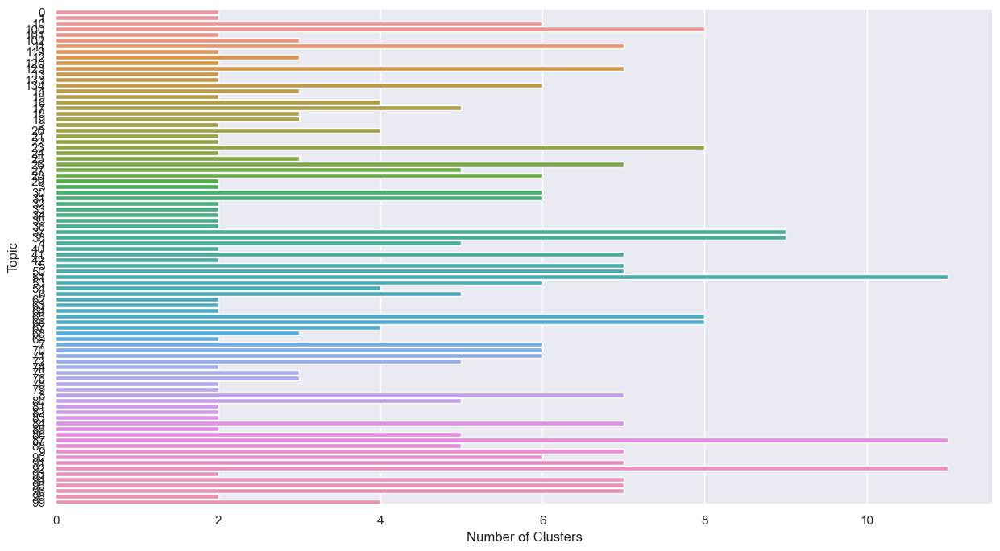

In [69]:
cluster_eval.display_number_of_clusters_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------


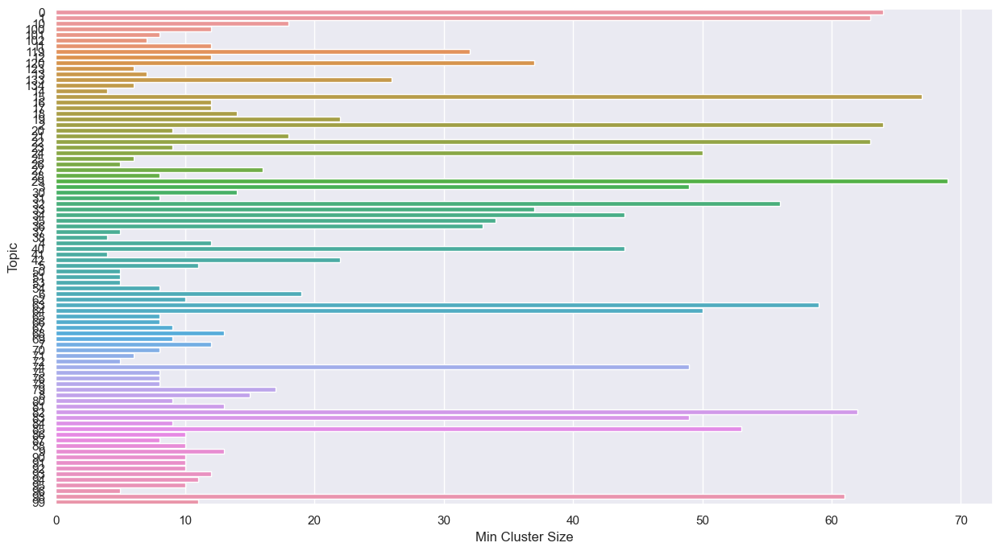

In [70]:
cluster_eval.display_min_cluster_size_all_group()

In [71]:
cluster_eval.print_min_cluster_sizes_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------
Topic  Min Cluster Size
   41                 4
   14                 4
   38                 4
   26                 5
   53                 5
   72                 5
   51                 5
   50                 5
   37                 5
   96                 5
  134                 6
   25                 6
   71                 6
  123                 6
   13                 7
  102                 7
   54                 8
   31                 8
   65                 8
   66                 8
   28                 8
   70                 8
   75         

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------


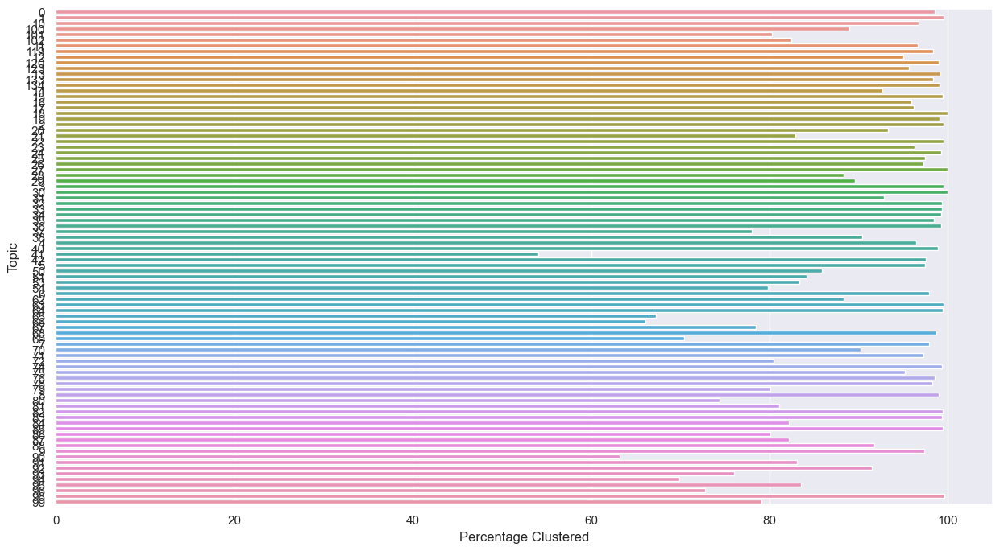

In [72]:
cluster_eval.display_percentage_clustered_all_group()

In [73]:
cluster_eval.print_percentage_clustered_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------
Topic  Percentage Clustered
   41             54.117647
   90             63.184080
   66             66.049383
   65             67.261905
   94             69.897959
   69             70.440252
   96             72.815534
   80             74.418605
   93             76.000000
   37             77.981651
   67             78.481013
   99             79.111111
   54             79.787234
   86             80.120482
   79             80.120482
  101             80.254777
   72             80.412371
   81             81.065089
   84             82.142857
  

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Size per Topic:
Cluster Size -> Number of User Learning Resource-Sequences
----------------------------------------------------------------------------------------------------
Plots:


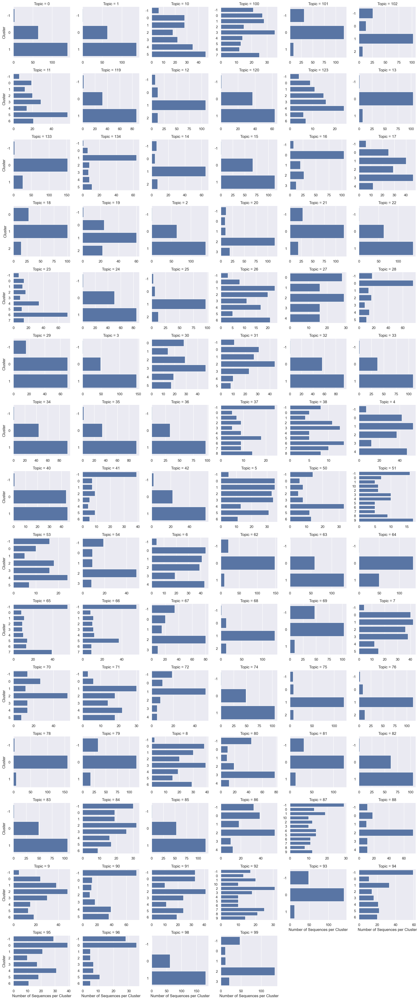

In [74]:
cluster_eval.display_cluster_size_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Central Tendency Differences in Evaluation Metric between Clusters per Topic:
Chosen Evaluation Metric: "Topic Is Correct All Learning Resources Mean"
----------------------------------------------------------------------------------------------------


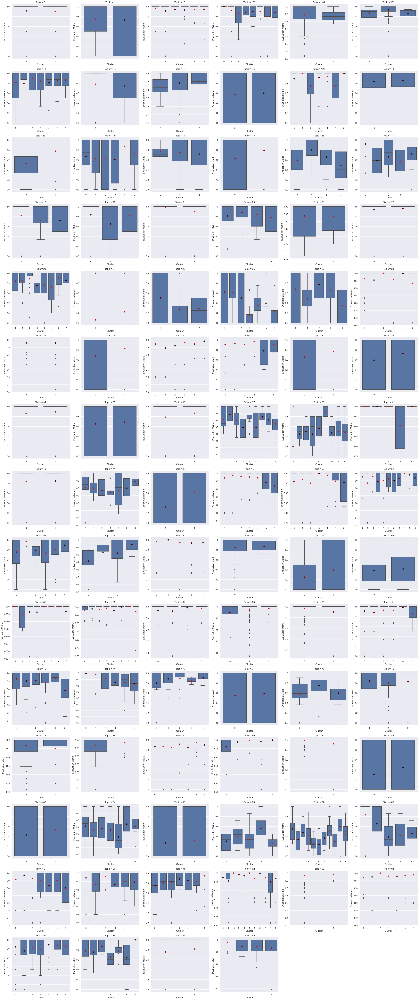

In [75]:
cluster_eval.display_eval_metric_dist_between_cluster_all_groups(height=5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Clusters per Group
Dimensionality Reducer: UMAP
----------------------------------------------------------------------------------------------------


c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  func(*plot_args, **plot_kwargs)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  func(*plot_args, **plot_kwargs)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: The palette list has more values (10) than needed (6), which may not be intended.
  func(*plot_args, **plot_kwargs)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: The palette list has more values (10) than needed (8), which may not be intended.
  func(*plot_args, **plot_kwargs)
c:\Users\sschmerda\Anaconda3\envs\DDIA\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: The palette list has more values (10) than needed (2), which 

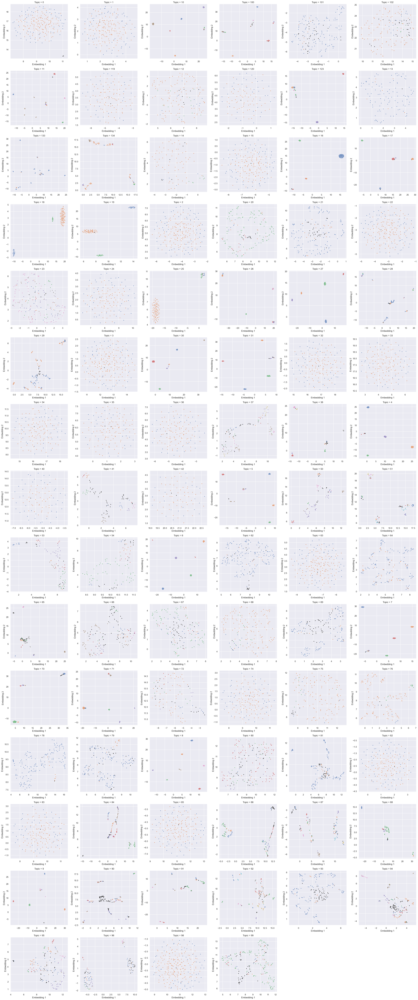

In [76]:
cluster_eval.display_clusters_all_group_umap(height=5)